## Dependencies

In [28]:
from itertools import combinations
from itertools import product

import math
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

In [29]:
plt.rcParams.update({'figure.dpi': 300, 'font.size': 10})

## Dataset

In [30]:
# reading in the heart disease dataset
df = pd.read_csv('../data/heart_disease_dataset.csv')

display(df)

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,num,location
0,63.0,Male,Typical Angina,145.0,233.0,Above 120,LV Hypertrophy,150.0,Exercise Angina Absent,2.3,Down,0 Vessel(s),Fixed Defect,0,Cleveland
1,67.0,Male,Asymptomatic,160.0,286.0,Below 120,LV Hypertrophy,108.0,Exercise Angina Present,1.5,Flat,3 Vessel(s),Normal,1,Cleveland
2,67.0,Male,Asymptomatic,120.0,229.0,Below 120,LV Hypertrophy,129.0,Exercise Angina Present,2.6,Flat,2 Vessel(s),Reversable Defect,1,Cleveland
3,37.0,Male,Nonanginal Pain,130.0,250.0,Below 120,Normal,187.0,Exercise Angina Absent,3.5,Down,0 Vessel(s),Normal,0,Cleveland
4,41.0,Female,Atypical Angina,130.0,204.0,Below 120,LV Hypertrophy,172.0,Exercise Angina Absent,1.4,Up,0 Vessel(s),Normal,0,Cleveland
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
792,54.0,Female,Asymptomatic,127.0,333.0,Above 120,ST-T Abnormality,154.0,Exercise Angina Absent,0.0,NaN,NaN,NaN,1,Long Beach
793,62.0,Male,Typical Angina,NaN,139.0,Below 120,ST-T Abnormality,NaN,NaN,NaN,NaN,NaN,NaN,0,Long Beach
794,55.0,Male,Asymptomatic,122.0,223.0,Above 120,ST-T Abnormality,100.0,Exercise Angina Absent,0.0,NaN,NaN,Fixed Defect,1,Long Beach
795,58.0,Male,Asymptomatic,NaN,385.0,Above 120,LV Hypertrophy,NaN,NaN,NaN,NaN,NaN,NaN,0,Long Beach


## Helper Functions

In [31]:
# defining the get_features_percent_missing function
def get_features_percent_missing(df):
    return df.isnull().sum() / df.shape[0]

In [32]:
# defining the get_points_percent_missing function
def get_points_percent_missing(df):
    return sum(df.isnull().sum(axis=1) != 0) / df.shape[0]

In [33]:
# defining the plot_bar function
def plot_bar(df, feature_1, x_label, y_label, title):
    counts = df[feature_1].value_counts()
    
    plt.bar(counts.index, counts.values, tick_label=counts.index)

    plt.title(title, pad=15)
    
    plt.xlabel(x_label, labelpad=10)
    plt.ylabel(y_label, labelpad=10)

    plt.savefig(f'../figures/eda_figures/bar_chart/{feature_1}.png', bbox_inches='tight')

    plt.show()

In [34]:
# defining the plot_bar_ratios function
def plot_bar_ratios(df, feature_1, x_label, y_label, title):
    ratios = df[feature_1].value_counts() / df[feature_1].shape[0]
    
    plt.bar(ratios.index, ratios.values, tick_label=ratios.index)

    plt.title(title, pad=15)
    
    plt.xlabel(x_label, labelpad=10)
    plt.ylabel(y_label, labelpad=10)

    plt.savefig(f'../figures/eda_figures/bar_chart/{feature_1}_ratios.png', bbox_inches='tight')

    plt.show()

In [35]:
# defining the plot_bar_stacked function
def plot_bar_stacked(df, feature_1, feature_2, x_label, y_label, title, legend):
    count_matrix = df.groupby([feature_1, feature_2]).size().unstack()
    count_matrix_norm = count_matrix.div(count_matrix.sum(axis=1), axis=0)

    count_matrix_norm.plot(kind='bar', stacked=True)

    plt.title(title, pad=15)
    
    plt.xlabel(x_label, labelpad=10)
    plt.ylabel(y_label, labelpad=10)

    plt.xticks(rotation=360)

    plt.legend(title=legend, bbox_to_anchor=(1.04, 1), loc='upper left')

    plt.savefig(f'../figures/eda_figures/stacked_bar_chart/{feature_1}_{feature_2}.png', bbox_inches='tight')

    plt.show()

In [36]:
# defining the plot_categorical_histogram function
def plot_categorical_histogram(df, feature_1, feature_2, x_label, y_label, title, legend):
    categories = df[feature_1].unique()
    bin_range = (df[feature_2].min() * 0.8, df[feature_2].max() * 0.8)

    bin_count = int(math.sqrt(max(df[feature_1].nunique(), df[feature_2].nunique())))

    for category in categories[~pd.isnull(categories)]:
        plt.hist(df[df[feature_1]==category][feature_2], alpha=0.5, label=category, range=bin_range, bins=15, density=True)

    plt.title(title, pad=15)
    
    plt.xlabel(x_label, labelpad=10)
    plt.ylabel(y_label, labelpad=10)

    plt.legend(title=legend, bbox_to_anchor=(1.04, 1), loc='upper left')

    plt.savefig(f'../figures/eda_figures/categorical_histogram/{feature_1}_{feature_2}.png', bbox_inches='tight')

    plt.show()

In [37]:
# defining the plot_box function
def plot_box(df, feature_1, feature_2, x_label, y_label, title):
    unique_feature_1 = df[feature_1].unique()
    sorted_feature_1 = sorted(unique_feature_1[~pd.isnull(unique_feature_1)])

    plt.boxplot([df[df[feature_1] == x][feature_2].dropna() for x in sorted_feature_1], labels=sorted_feature_1)

    plt.title(title, pad=15)
    
    plt.xlabel(x_label, labelpad=10)
    plt.ylabel(y_label, labelpad=10)

    plt.savefig(f'../figures/eda_figures/box_plot/{feature_1}_{feature_2}.png', bbox_inches='tight')

    plt.show()

In [38]:
# defining the plot_categorical_scatter_u function
def plot_categorical_scatter_u(df, feature_1, feature_2, feature_3, x_label, y_label, title, legend):
    data = df[[feature_1, feature_2]].values
    labels = np.array(df[feature_3])
    
    indices = pd.isnull(labels)

    data, labels = data[~indices], labels[~indices]

    for label in sorted(set(labels)):
        x = [data[i][0] for i in range(len(data)) if labels[i] == label]
        y = [data[i][1] for i in range(len(data)) if labels[i] == label]
        
        plt.scatter(x, y, label=label)

    plt.title(title, pad=15)

    plt.xlabel(x_label, labelpad=10)
    plt.ylabel(y_label, labelpad=10)

    plt.legend(title=legend, bbox_to_anchor=(1.04, 1), loc='upper left')

    plt.savefig(f'../figures/eda_figures/categorical_scatter_plot/{feature_1}_{feature_2}_{feature_3}.png', bbox_inches='tight')

    plt.show()

In [39]:
# defining the plot_categorical_scatter_f function
def plot_categorical_scatter_f(df, feature_1, feature_2, feature_3, x_label, y_label, title, legend):
    data = df[[feature_1, feature_2]].values
    labels = np.array(df[feature_3])
    
    indices = pd.isnull(labels)

    data, labels = data[~indices], labels[~indices]

    for label in sorted(set(labels)):
        x = [data[i][0] for i in range(len(data)) if labels[i] == label]
        y = [data[i][1] for i in range(len(data)) if labels[i] == label]
        
        plt.scatter(x, y, label=label)
        
        indices = np.array(np.logical_not(np.logical_or(np.isnan(x), np.isnan(y))))

        z = np.polyfit(np.array(x)[indices], np.array(y)[indices], 1)
        p = np.poly1d(z)

        plt.plot(x, p(x), linewidth=5)

    plt.title(title, pad=15)

    plt.xlabel(x_label, labelpad=10)
    plt.ylabel(y_label, labelpad=10)

    plt.legend(title=legend, bbox_to_anchor=(1.04, 1), loc='upper left')

    plt.savefig(f'../figures/eda_figures/categorical_scatter_plot/{feature_1}_{feature_2}_{feature_3}_fits.png', bbox_inches='tight')

    plt.show()

## EDA

### Dataset Statistics

In [40]:
# getting the dataset dimensions
rows, cols = df.shape

print('Number Of Rows: ' + str(rows))
print('Number Of Cols: ' + str(cols))

Number Of Rows: 797
Number Of Cols: 15


In [41]:
# getting the dataframe column types
pd.set_option('display.max_rows', cols)

print(df.dtypes)

age         float64
sex          object
cp           object
trestbps    float64
chol        float64
fbs          object
restecg      object
thalach     float64
exang        object
oldpeak     float64
slope        object
ca           object
thal         object
num           int64
location     object
dtype: object


In [42]:
# describing the dataset target variable
print(df['num'].describe())

count    797.000000
mean       0.494354
std        0.500282
min        0.000000
25%        0.000000
50%        0.000000
75%        1.000000
max        1.000000
Name: num, dtype: float64


In [43]:
# initializing the categorical features and numerical features
cat_ftrs = ['sex', 'cp', 'fbs', 'restecg', 'exang', 'slope', 'ca', 'thal', 'location']
num_ftrs = ['age', 'trestbps', 'chol', 'thalach', 'oldpeak']

In [44]:
# initializing the feature names and feature units
ftr_names = {
    'age': 'Age',
    'sex': 'Sex',
    'cp': 'Chest Pain',
    'trestbps': 'Resting Blood Pressure',
    'chol': 'Serum Cholesterol',
    'fbs': 'Fasting Blood Sugar',
    'restecg': 'Electrocardiographic Results',
    'thalach': 'Maximum Heart Rate',
    'exang': 'Resting Blood Pressure',
    'oldpeak': 'ST Depression',
    'slope': 'Slope Of ST Segment',
    'ca': 'Number Of Major Vessels',
    'thal': 'Thalassemia',
    'num': 'Heart Disease Diagnosis',
    'location': 'Data Location'
}

ftr_units = {
    'age': '(Years)',
    'chol': '(mg/dL)',
    'fbs': '(mg/dL)',
    'trestbps': '(mmHg)'
}

In [45]:
# calculating missing values statistics for the dataset
print(f'Data Dimensions: {df.shape}\n')

percent_missing_per_feature = get_features_percent_missing(df)

print(f'Fraction Of Missing Values In Features:\n{percent_missing_per_feature[percent_missing_per_feature > 0]}\n')

print(f'Data Types Of Features With Missing Values:\n{df[percent_missing_per_feature[percent_missing_per_feature > 0].index].dtypes}\n')

print(f'Fraction Of Points With Missing Values:\n{get_points_percent_missing(df)}\n')

Data Dimensions: (797, 15)

Fraction Of Missing Values In Features:
trestbps    0.072773
chol        0.099122
fbs         0.018821
restecg     0.001255
thalach     0.067754
exang       0.067754
oldpeak     0.070263
slope       0.366374
ca          0.618570
thal        0.544542
dtype: float64

Data Types Of Features With Missing Values:
trestbps    float64
chol        float64
fbs          object
restecg      object
thalach     float64
exang        object
oldpeak     float64
slope        object
ca           object
thal         object
dtype: object

Fraction Of Points With Missing Values:
0.6248431618569636



### Target Variable

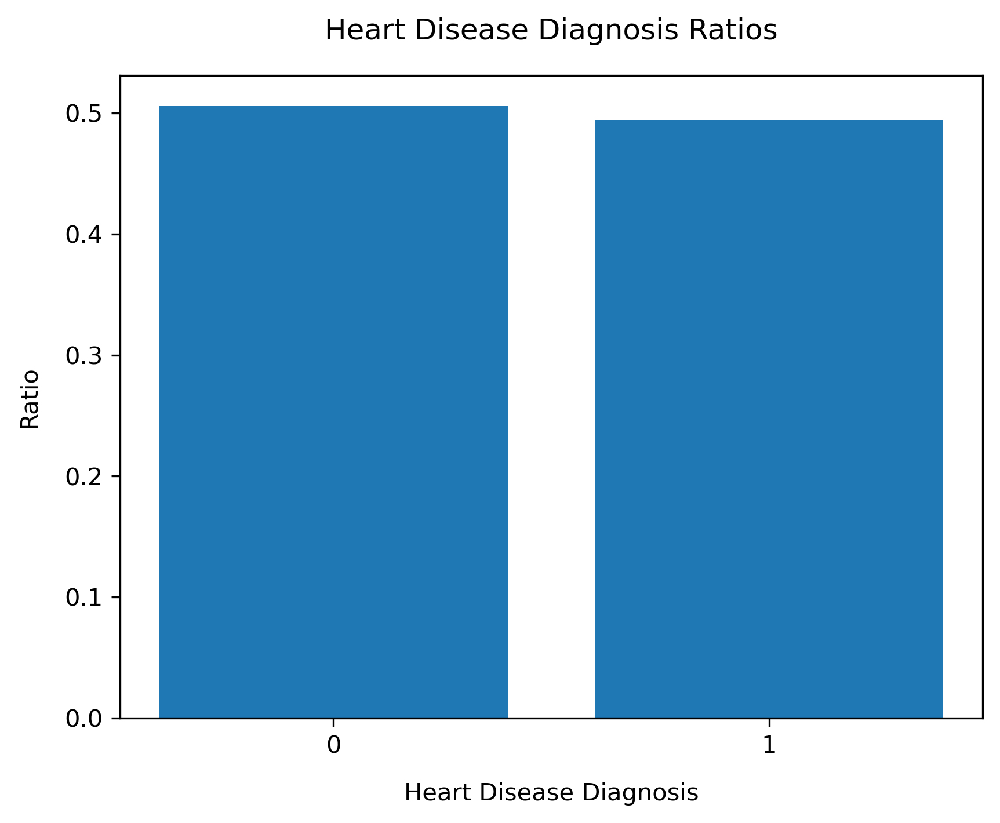

In [46]:
# plotting a ratio bar plot for the target variable
plot_bar_ratios(df, 'num', 'Heart Disease Diagnosis', 'Ratio', 'Heart Disease Diagnosis Ratios')

### Bar Plots

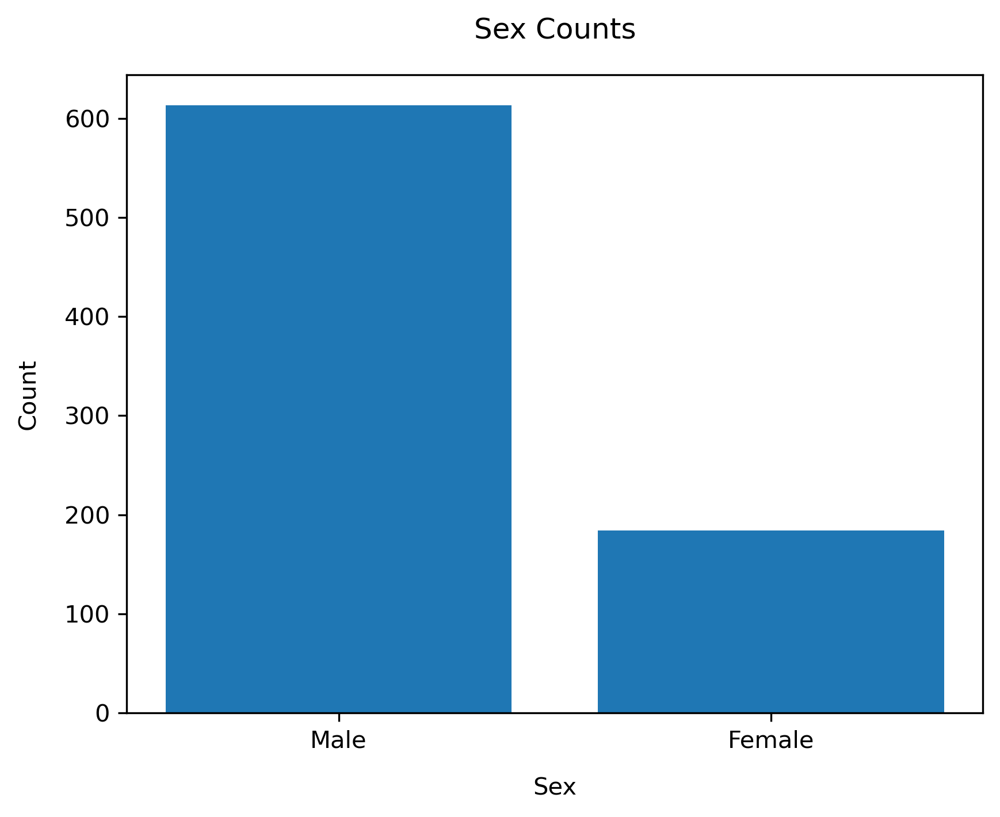

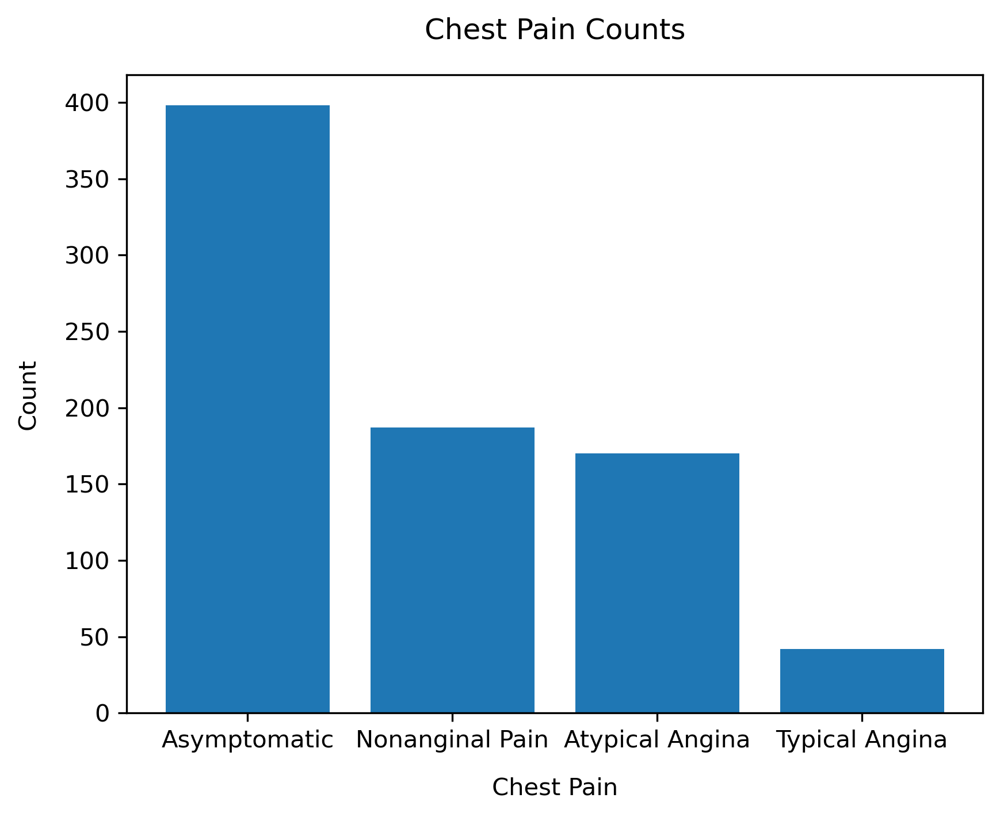

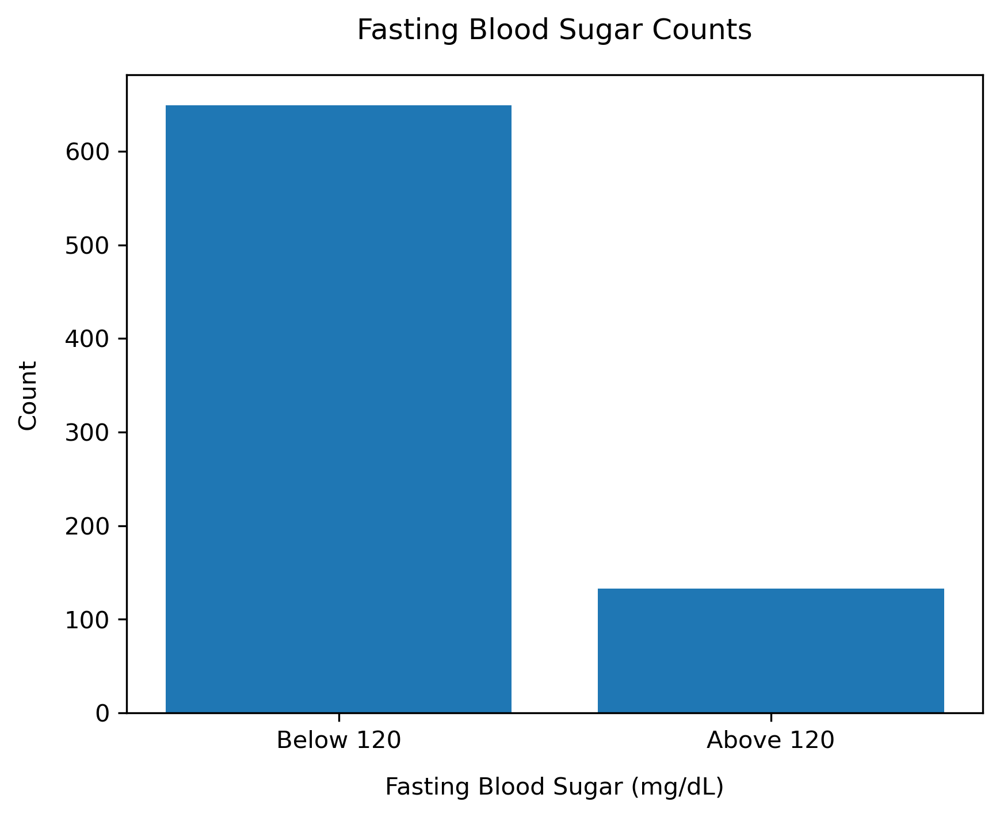

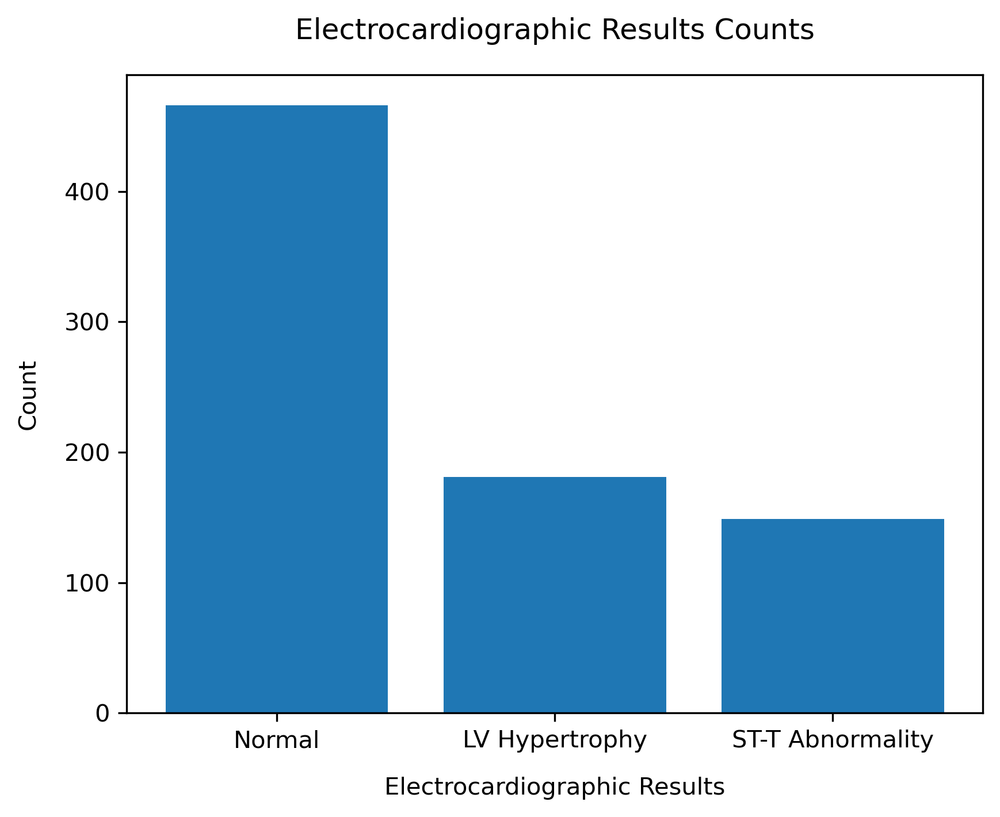

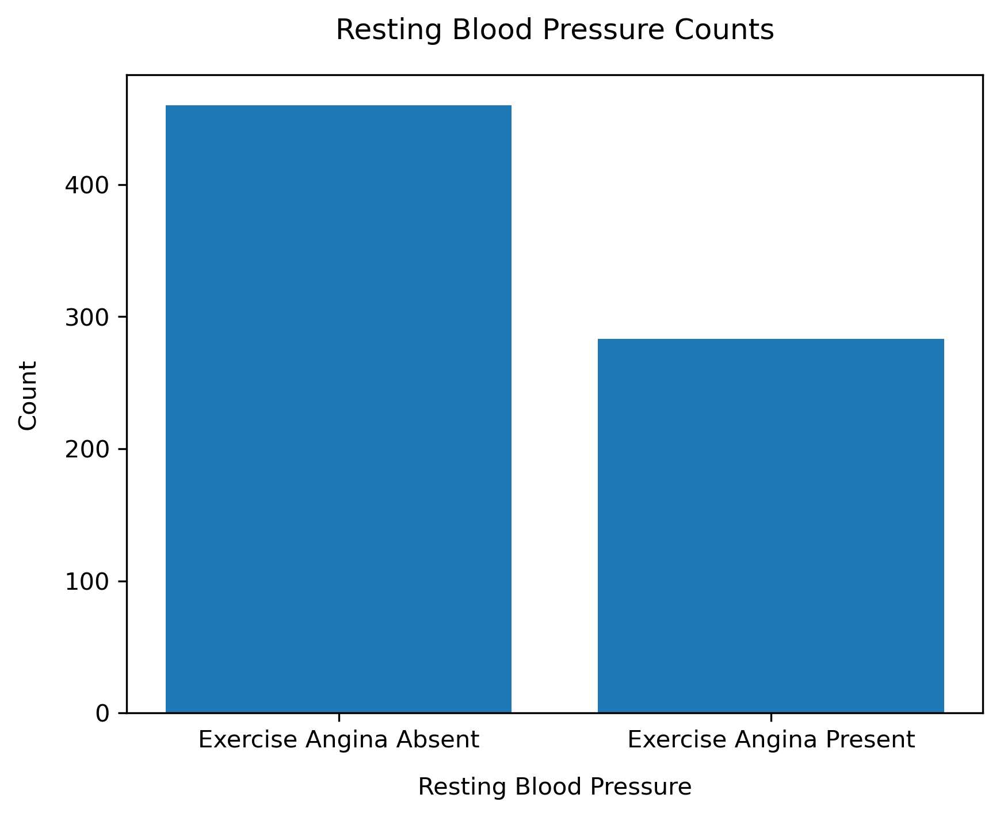

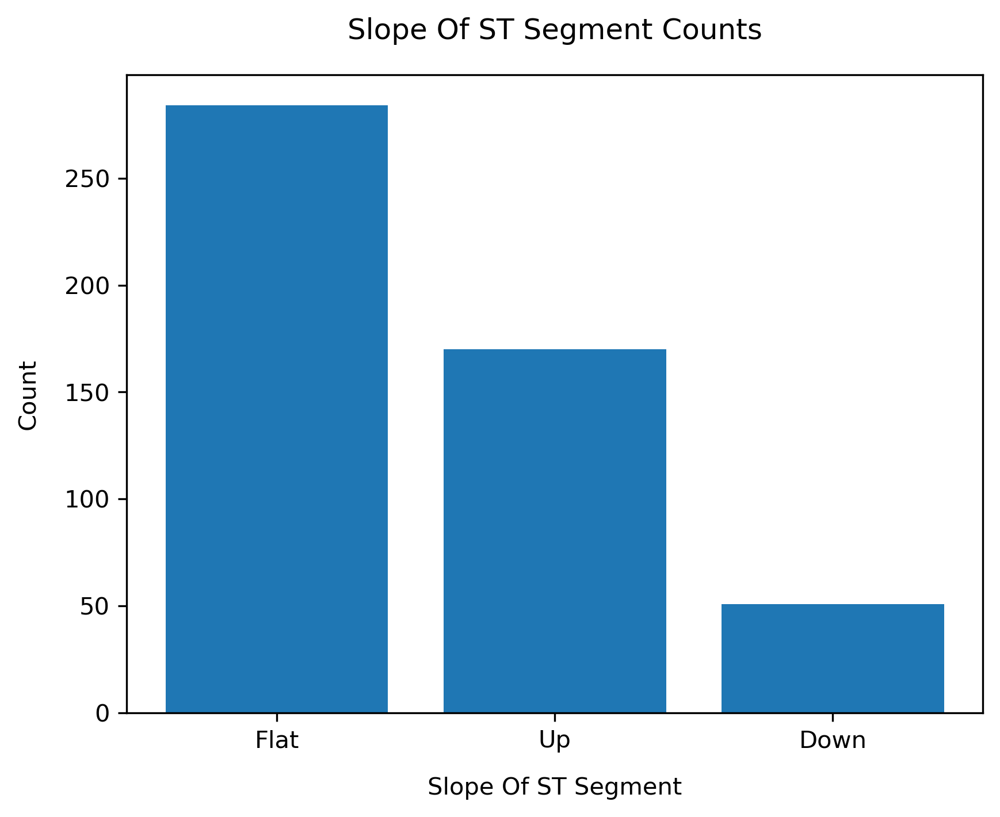

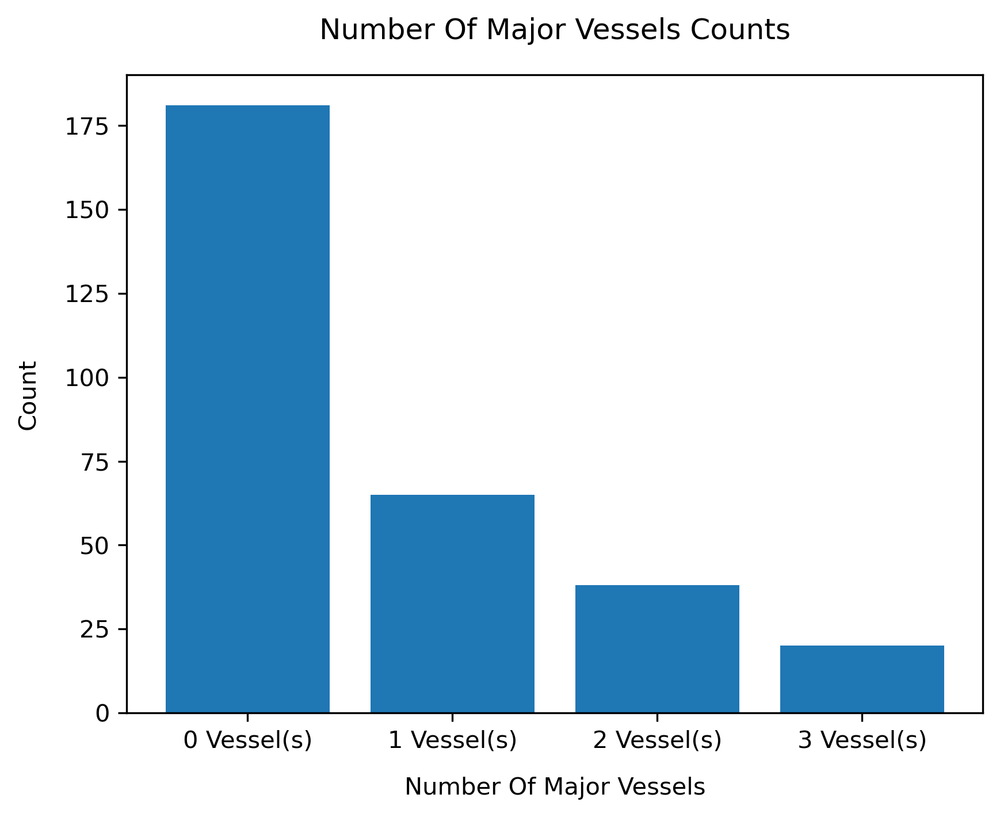

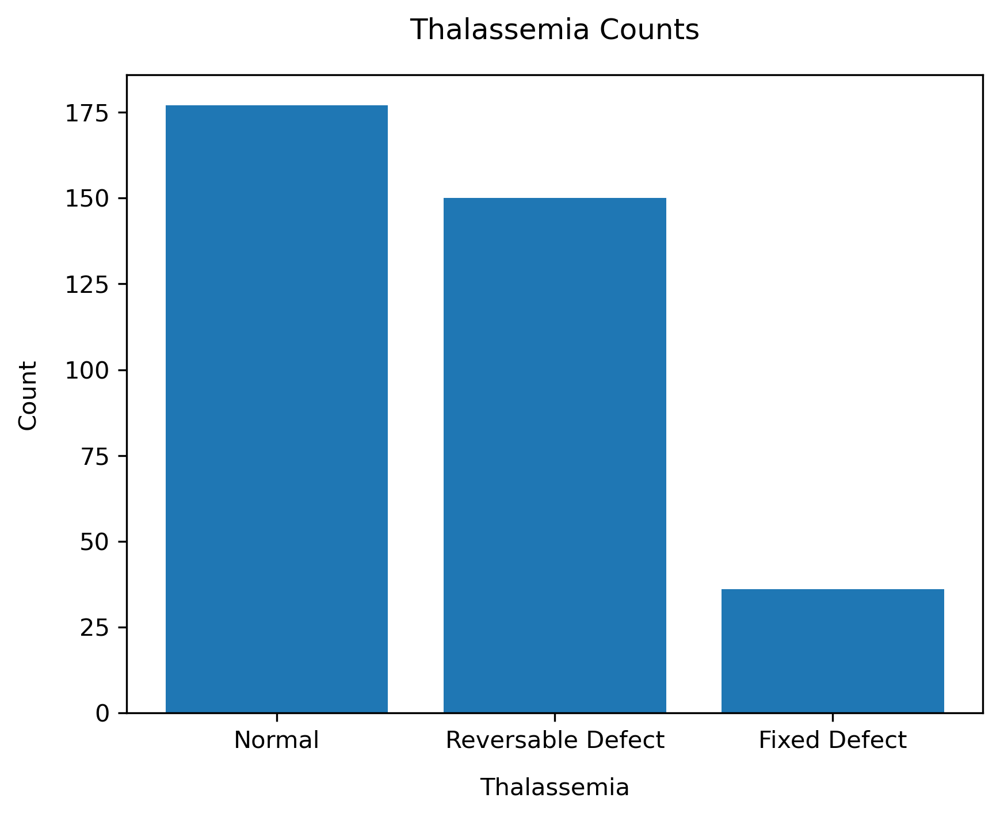

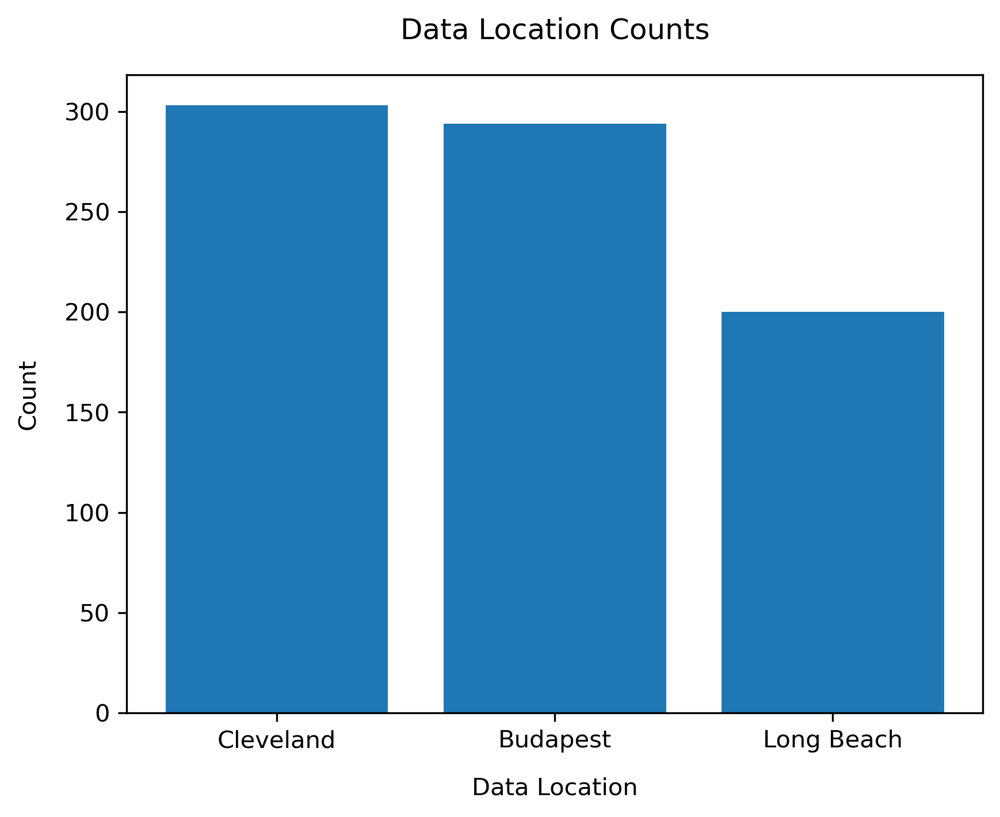

In [47]:
# plotting a bar plot for all of the relevant features
for cat_ftr in cat_ftrs:
    # initializing the feature name and axis label
    cat_ftr_name = ftr_names[cat_ftr]
    cat_ftr_axis = f'{cat_ftr_name} {ftr_units[cat_ftr]}' if cat_ftr in ftr_units else cat_ftr_name
    
    # plotting a bar plot for the current feature
    plot_bar(df, cat_ftr, cat_ftr_axis, 'Count', f'{cat_ftr_name} Counts')

### Stacked Bar Plots

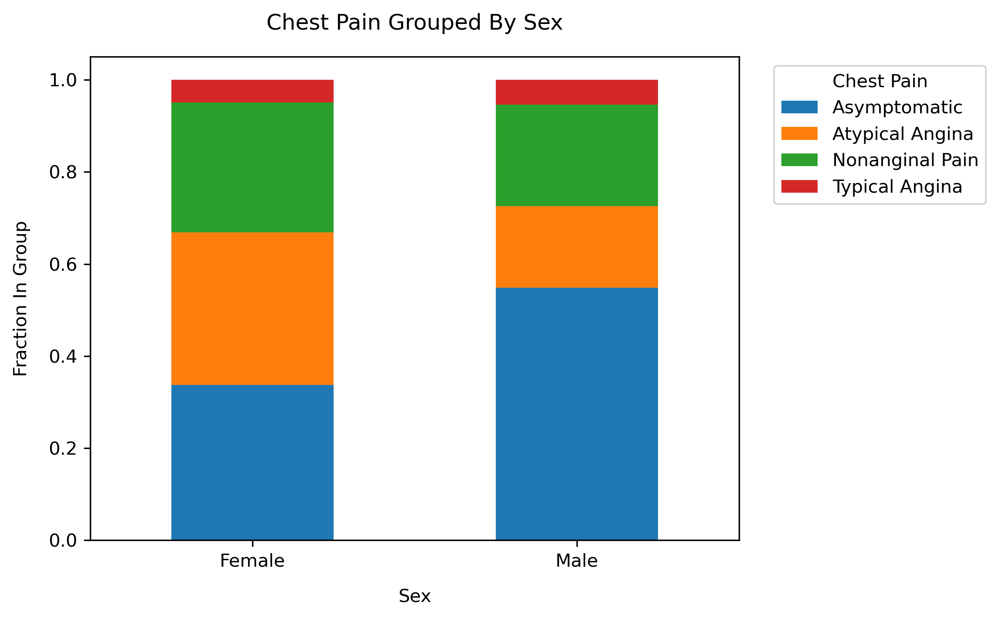

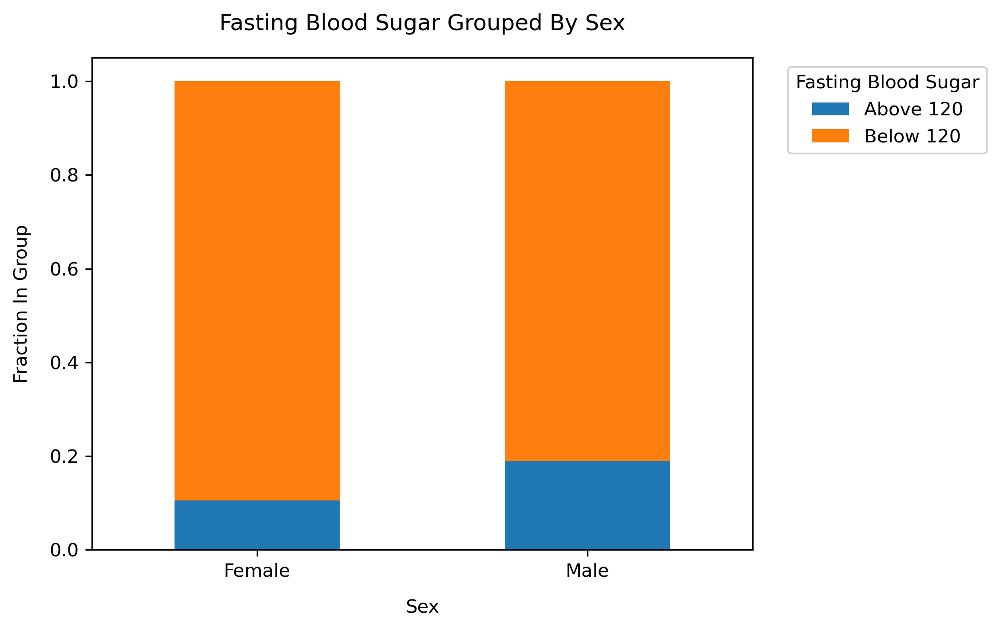

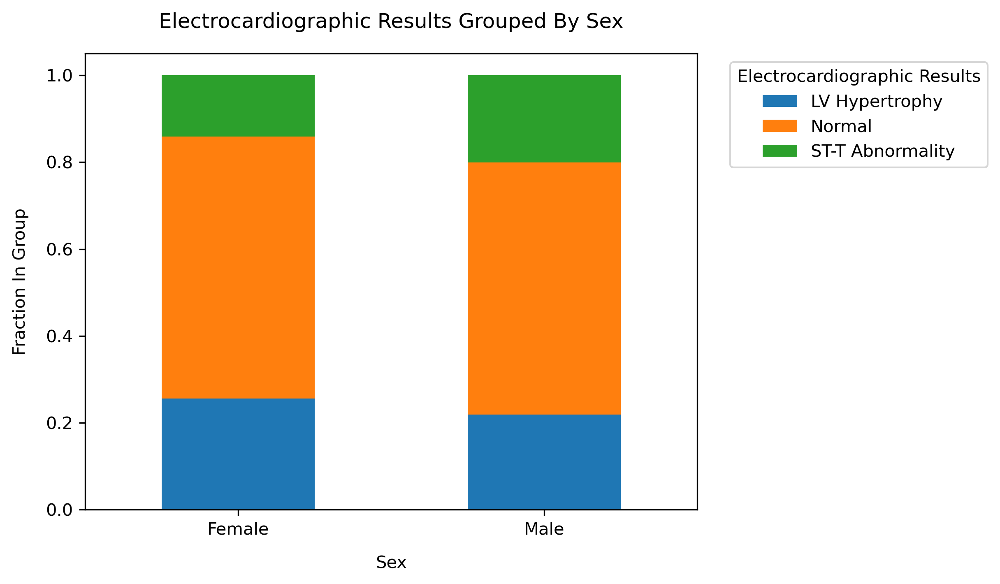

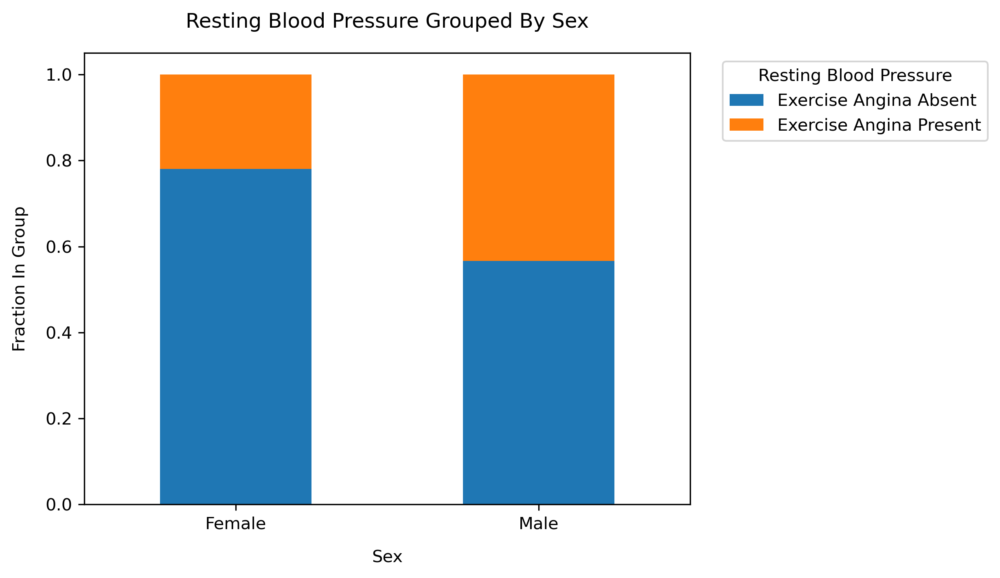

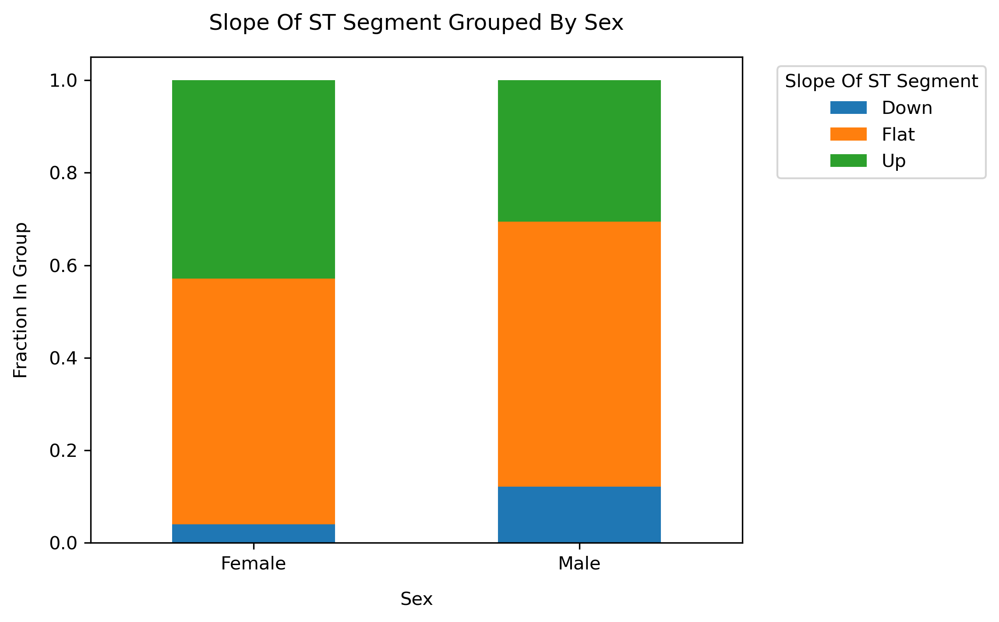

...

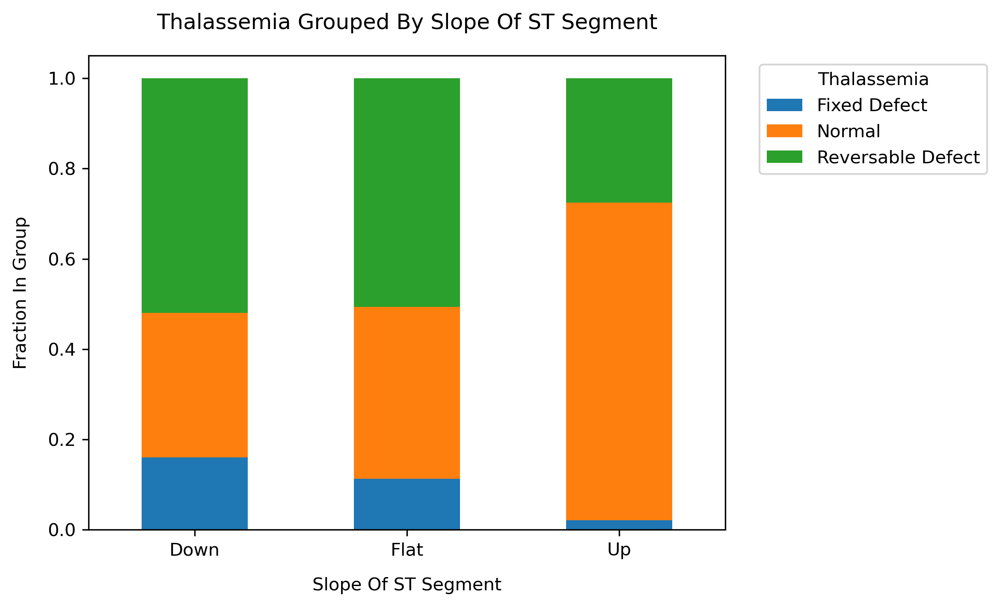

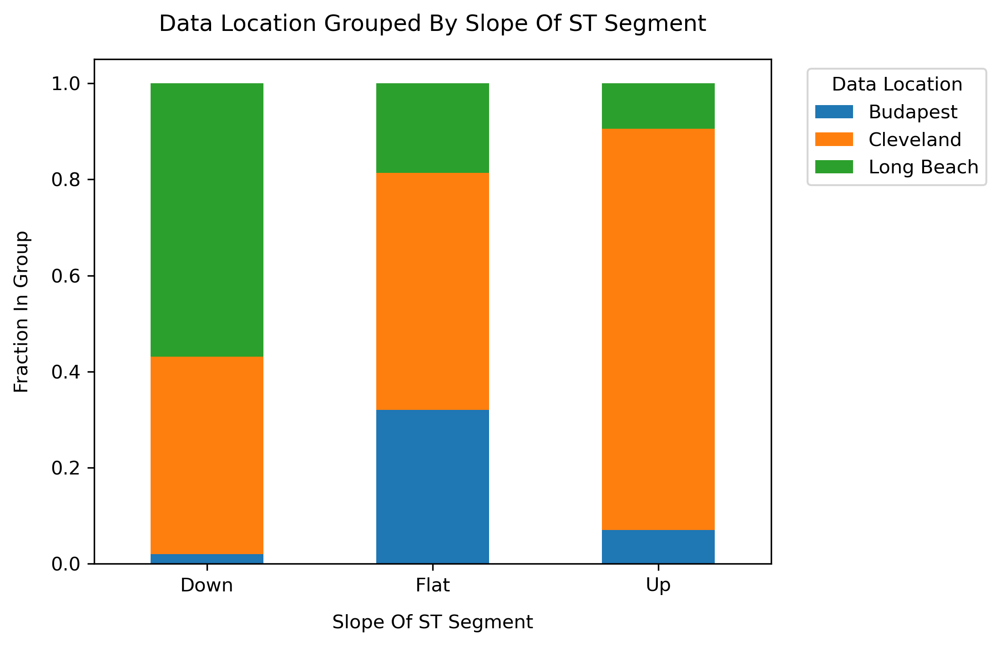

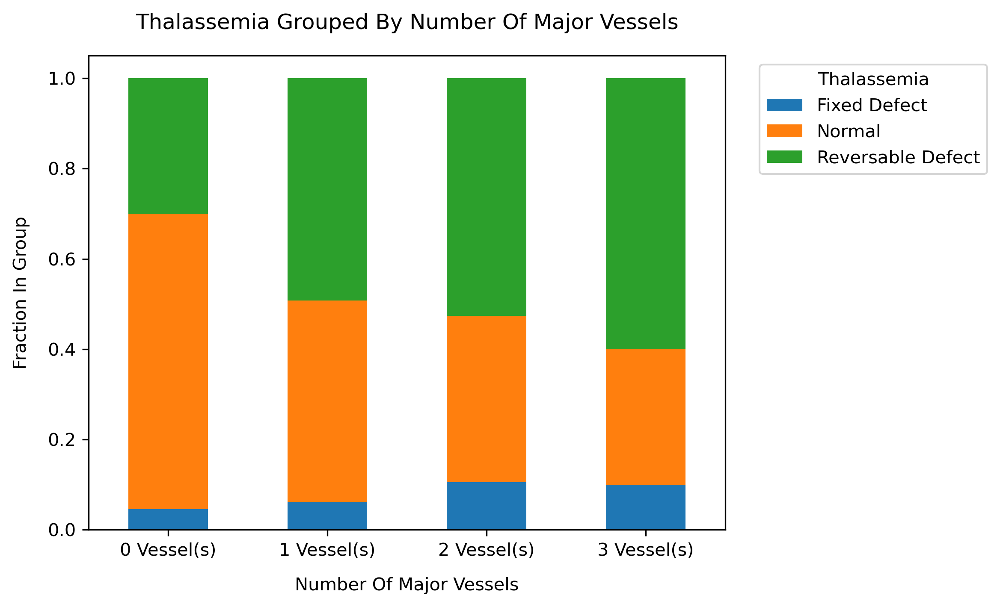

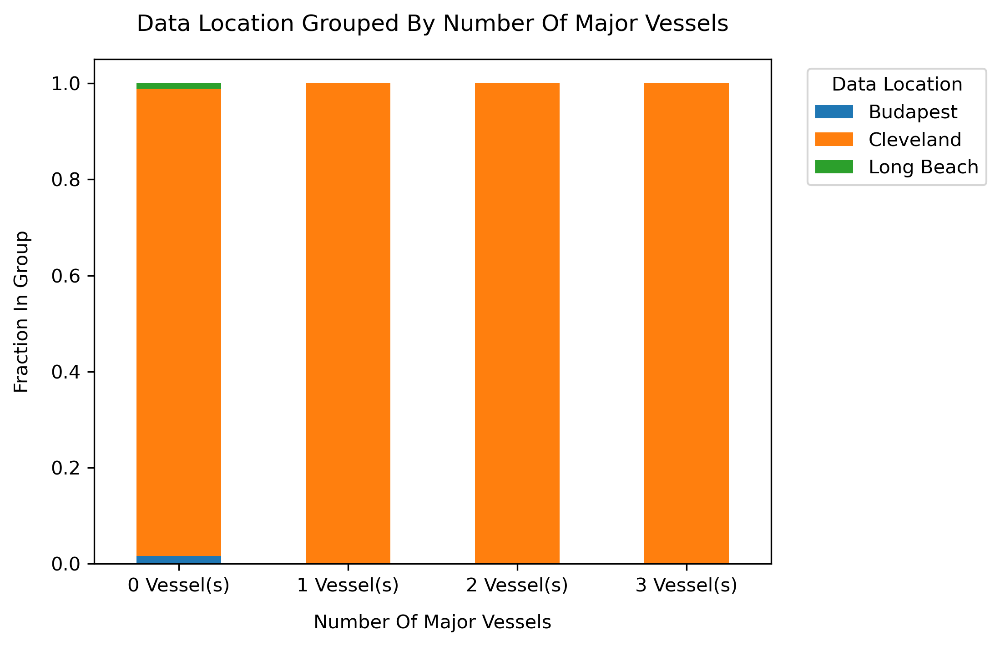

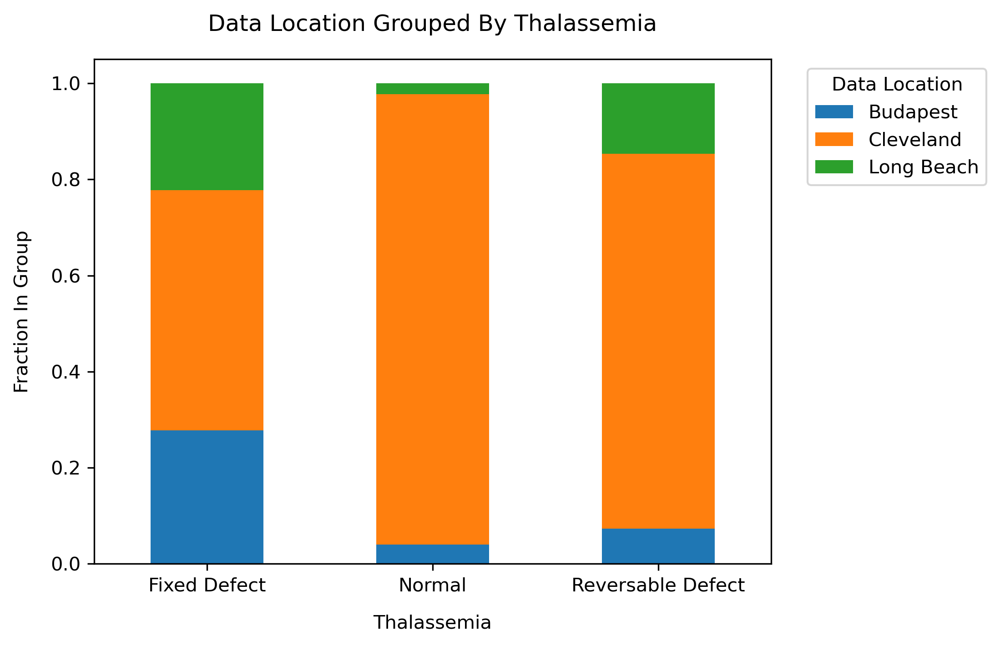

In [48]:
# plotting a stacked bar plot for all of the relevant features
for cat_ftr1, cat_ftr2 in combinations(cat_ftrs, 2):
    # initializing the feature name and axis label
    cat_ftr1_name = ftr_names[cat_ftr1]
    cat_ftr1_axis = f'{cat_ftr1_name} {ftr_units[cat_ftr1]}' if cat_ftr1 in ftr_units else cat_ftr1_name

    # initializing the feature name and axis label
    cat_ftr2_name = ftr_names[cat_ftr2]
    cat_ftr2_axis = f'{cat_ftr2_name} {ftr_units[cat_ftr2]}' if cat_ftr2 in ftr_units else cat_ftr2_name

    # plotting a stacked bar plot for the current features
    plot_bar_stacked(df, cat_ftr1, cat_ftr2, cat_ftr1_axis, 'Fraction In Group', f'{cat_ftr2_name} Grouped By {cat_ftr1_name}', cat_ftr2_name)

### Categorical Histograms

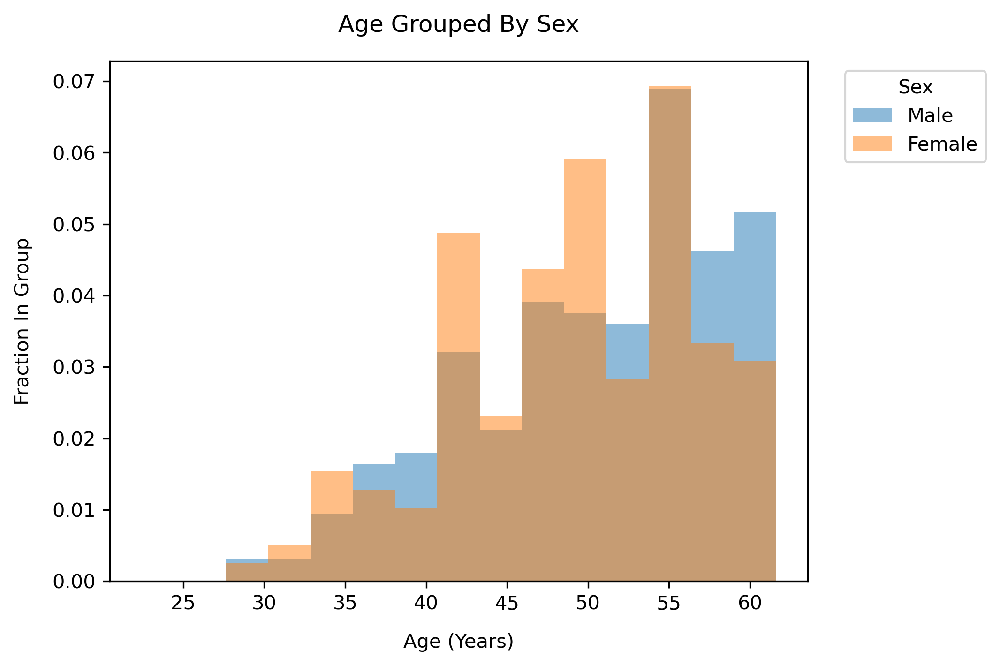

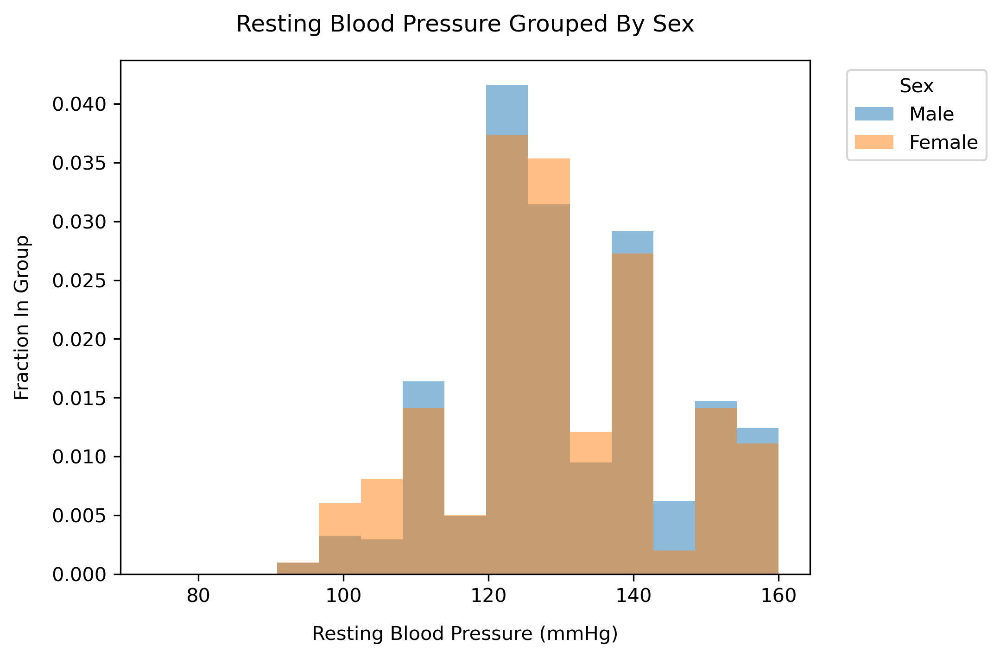

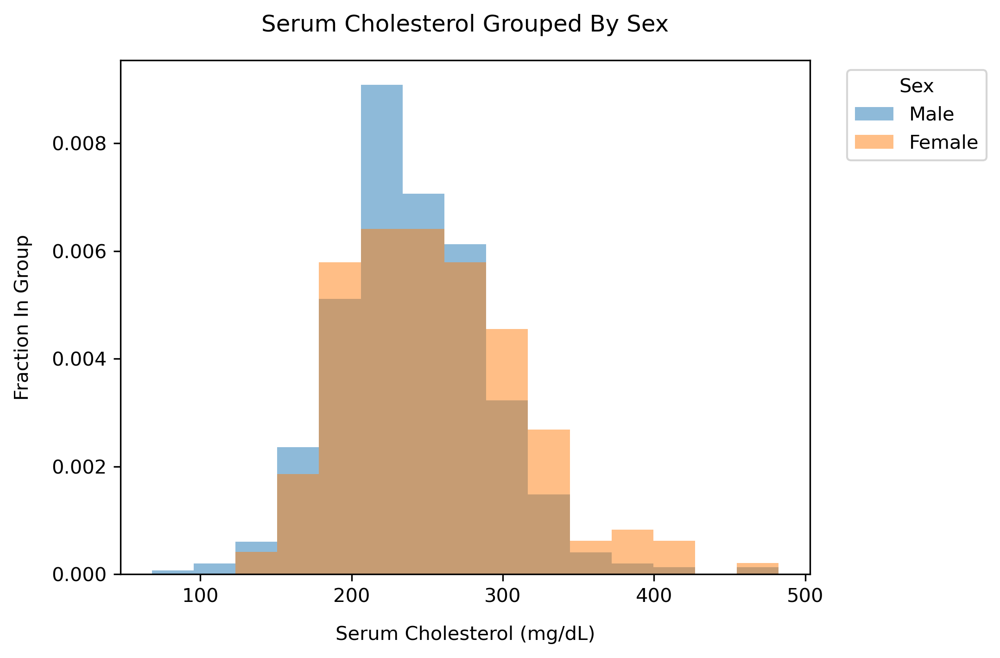

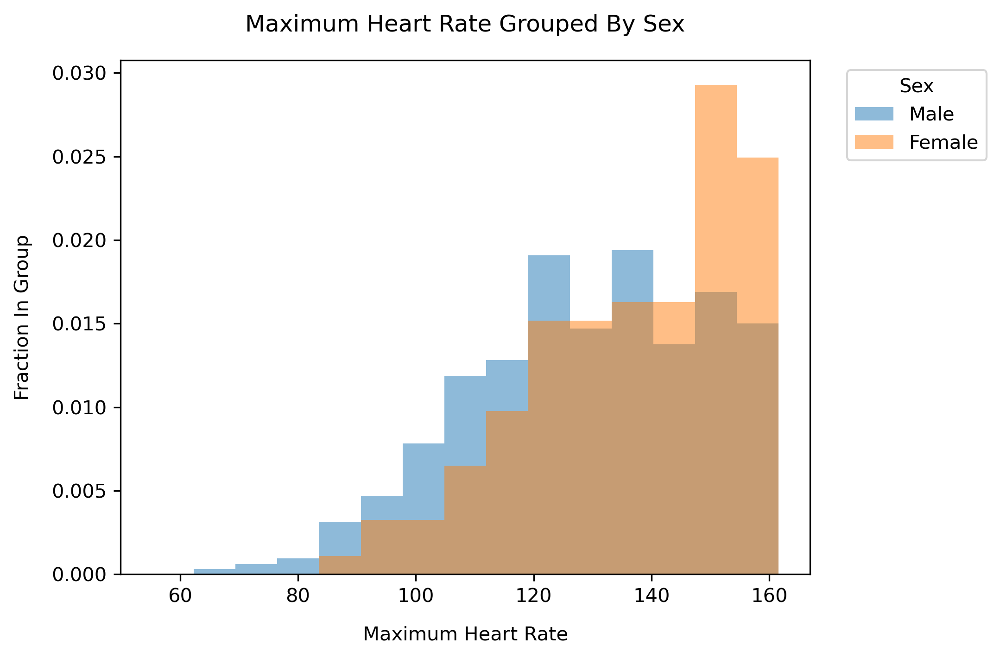

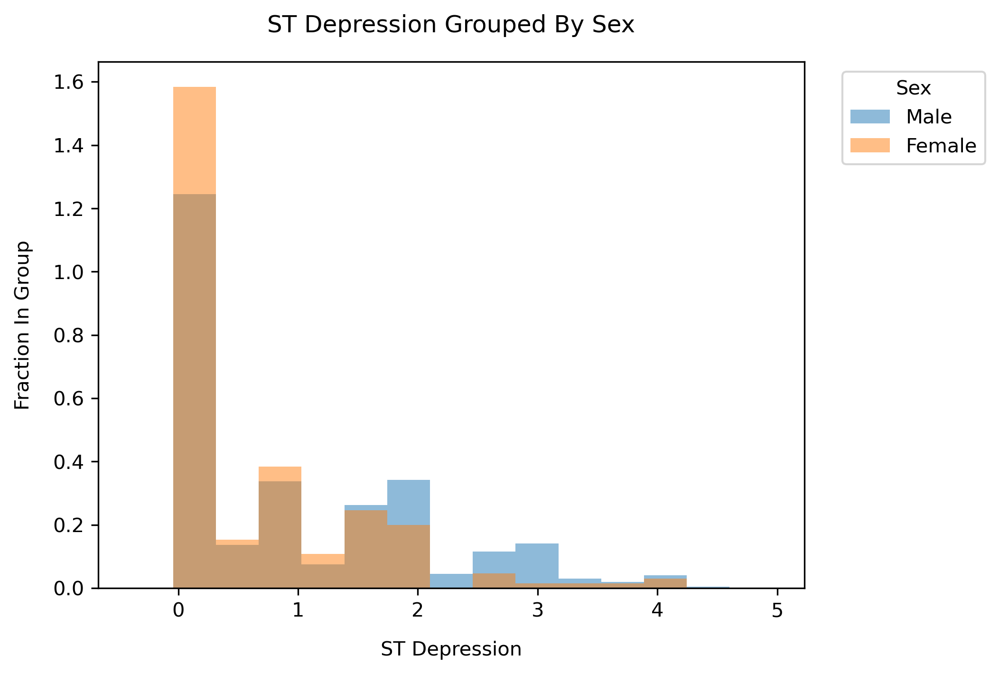

...

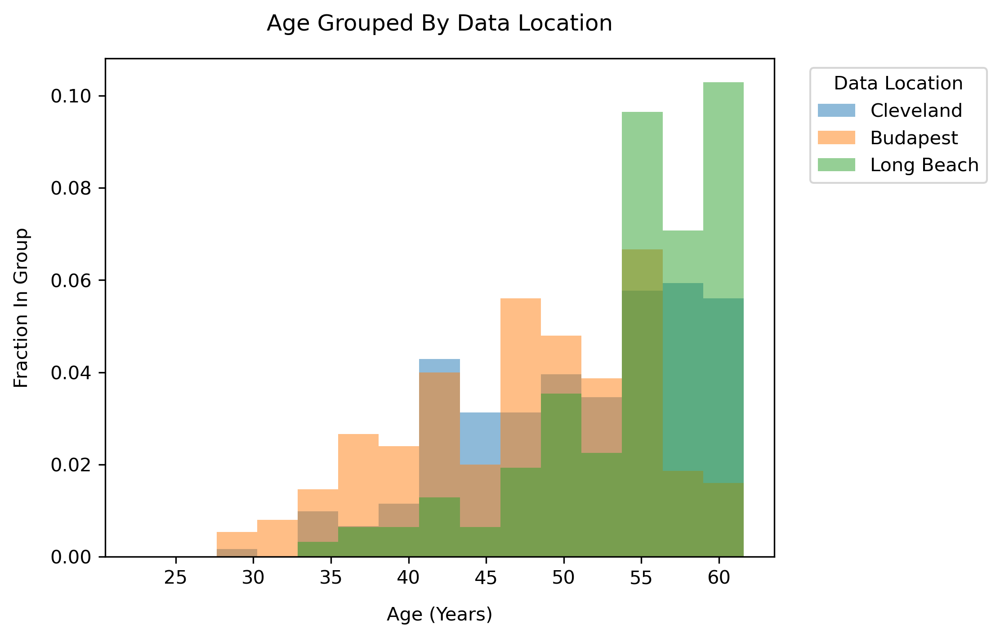

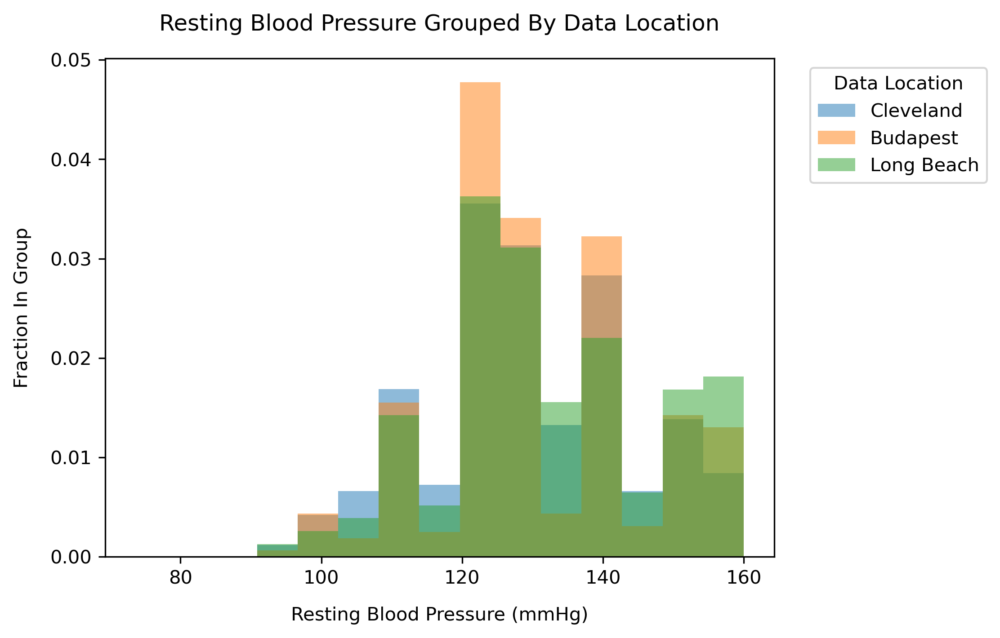

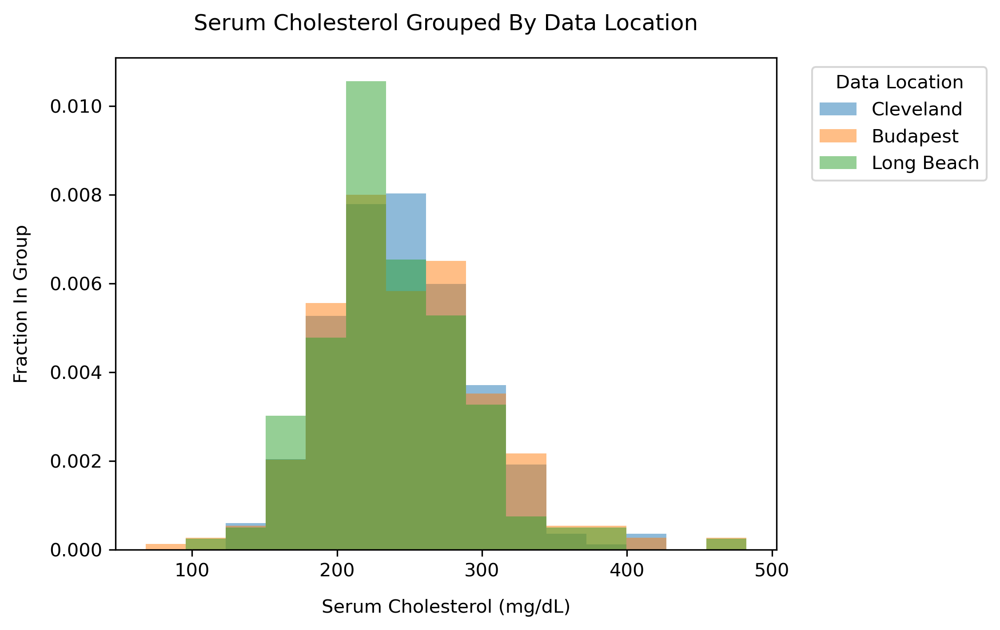

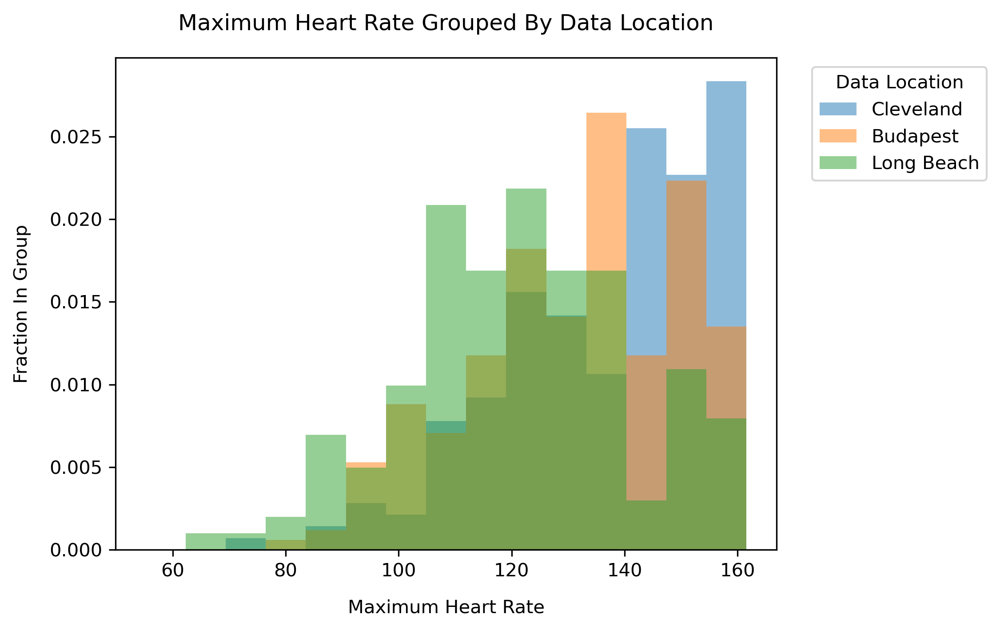

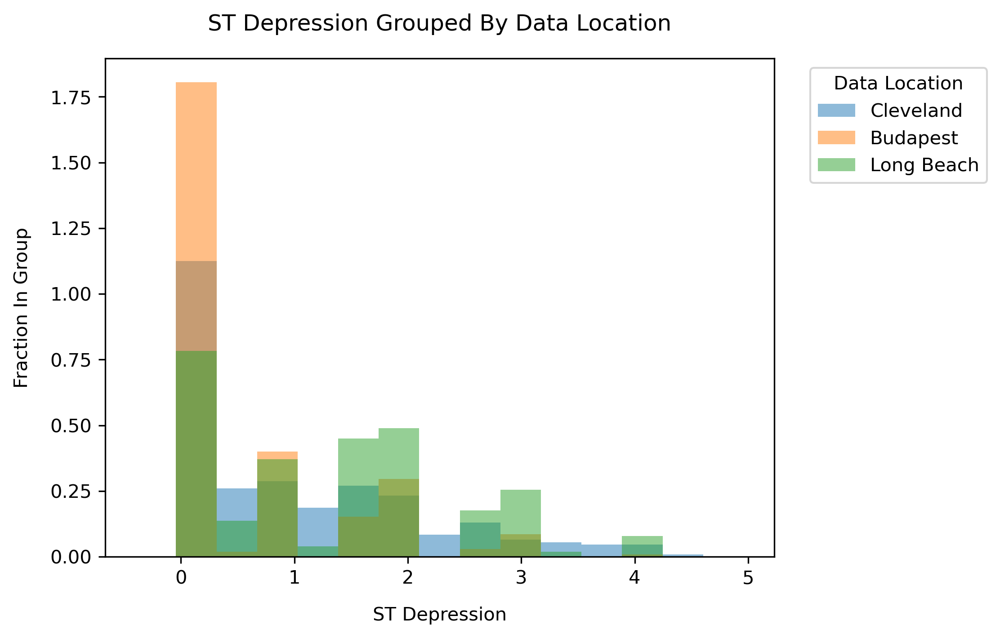

In [49]:
# plotting a categorical histogram for all of the relevant features
for cat_ftr, num_ftr in product(cat_ftrs, num_ftrs):
    # initializing the feature name and axis label
    cat_ftr_name = ftr_names[cat_ftr]
    cat_ftr_axis = f'{cat_ftr_name} {ftr_units[cat_ftr]}' if cat_ftr in ftr_units else cat_ftr_name

    # initializing the feature name and axis label
    num_ftr_name = ftr_names[num_ftr]
    num_ftr_axis = f'{num_ftr_name} {ftr_units[num_ftr]}' if num_ftr in ftr_units else num_ftr_name

    # plotting a categorical histogram for the current features
    plot_categorical_histogram(df, cat_ftr, num_ftr, num_ftr_axis, 'Fraction In Group', f'{num_ftr_name} Grouped By {cat_ftr_name}', cat_ftr_name)

### Box Plots

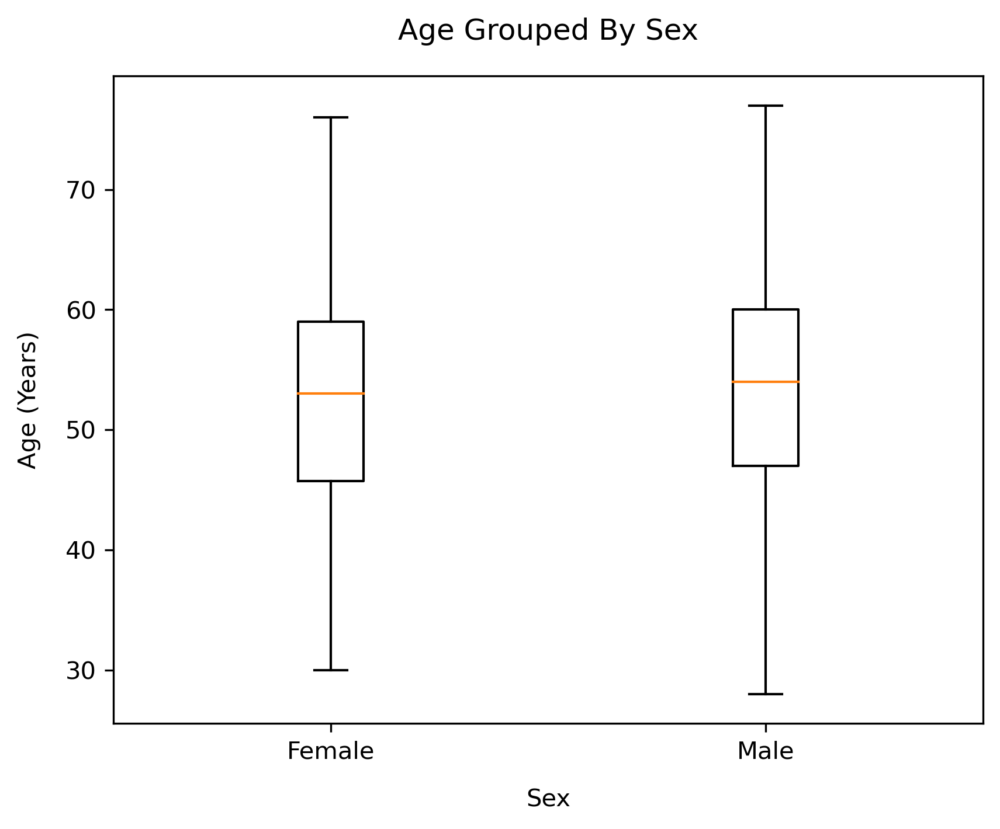

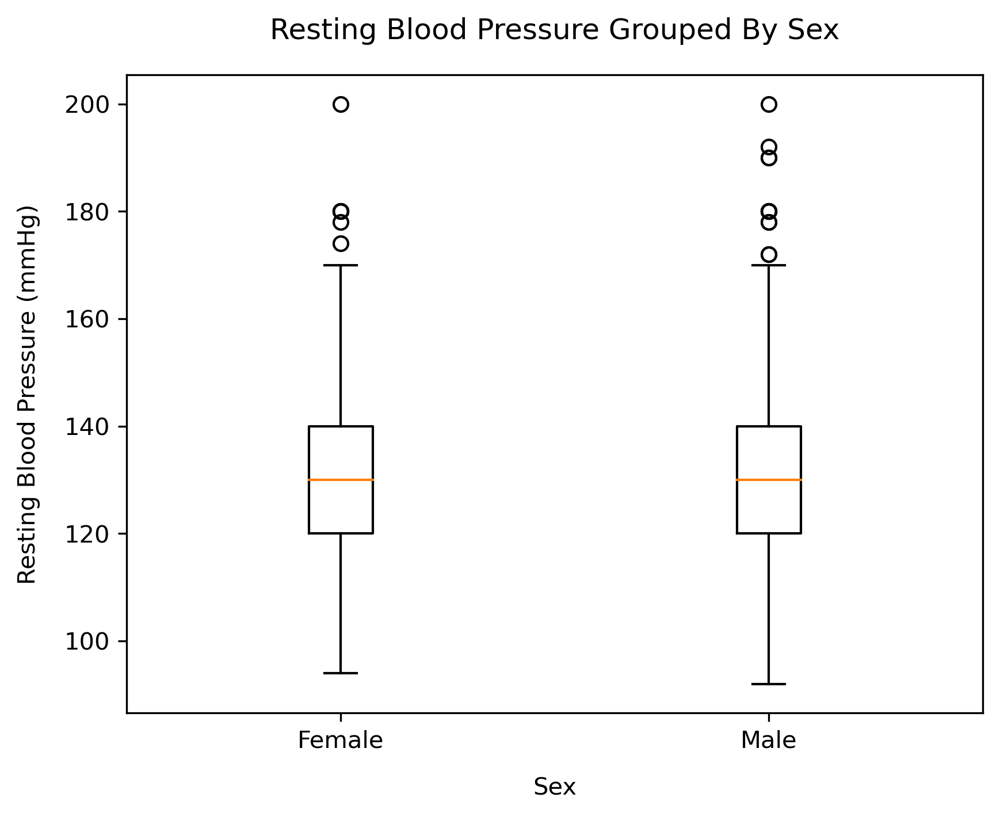

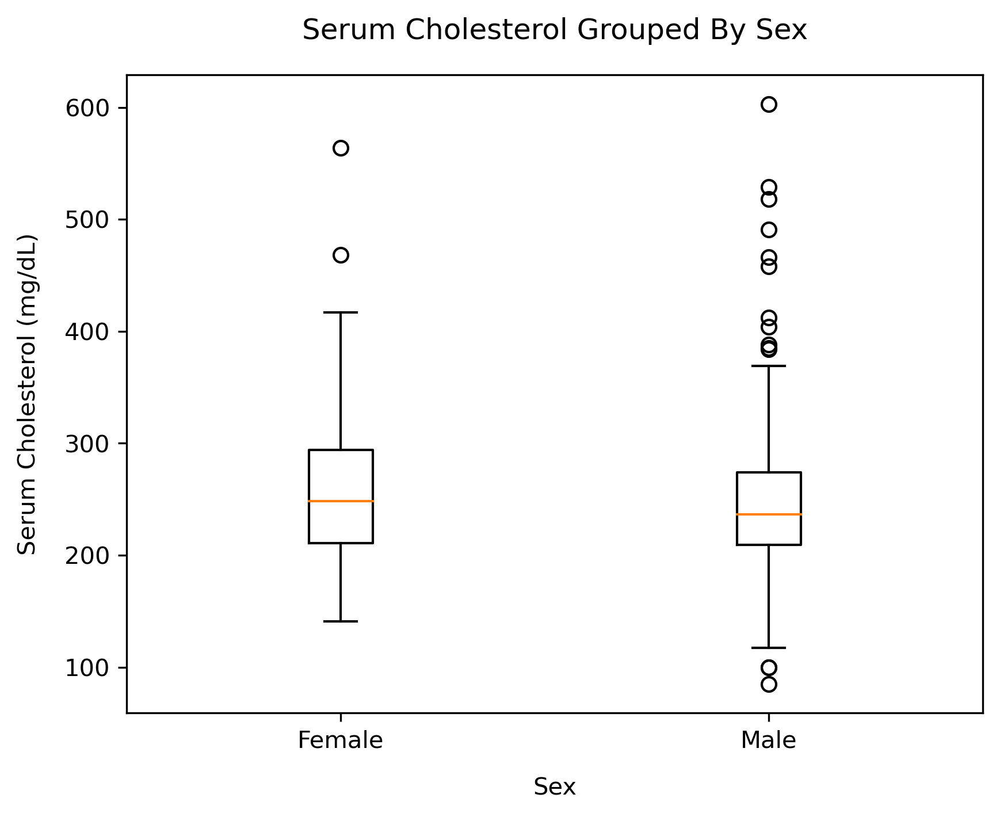

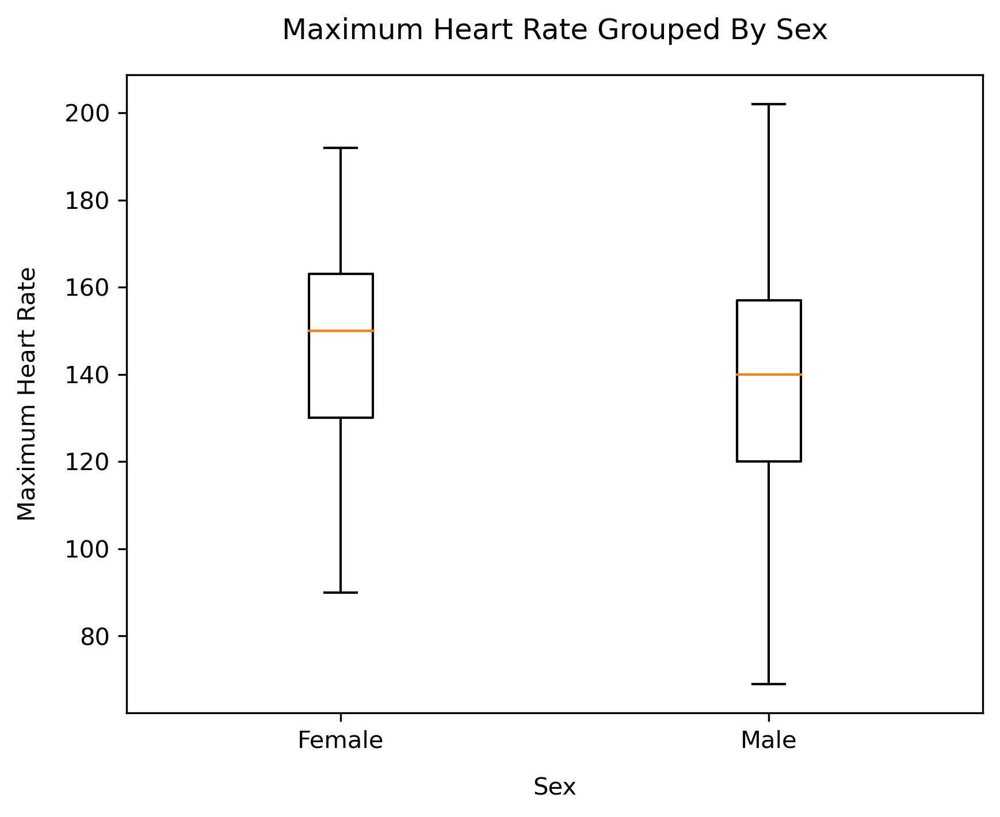

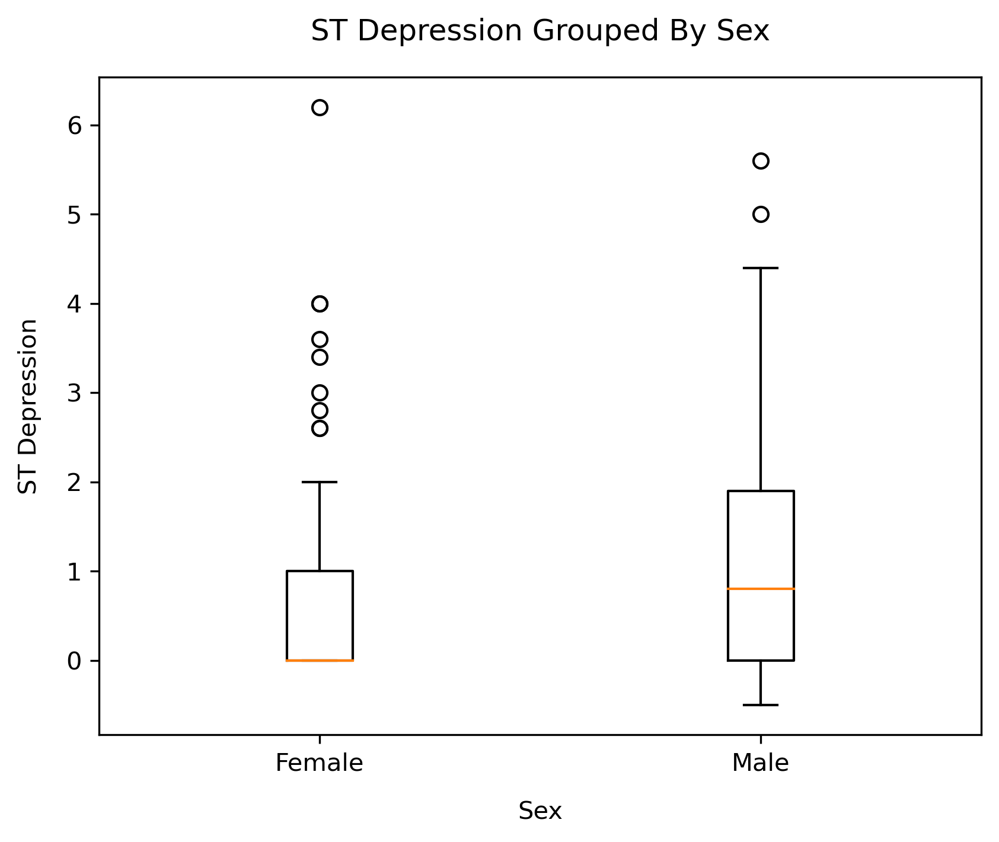

...

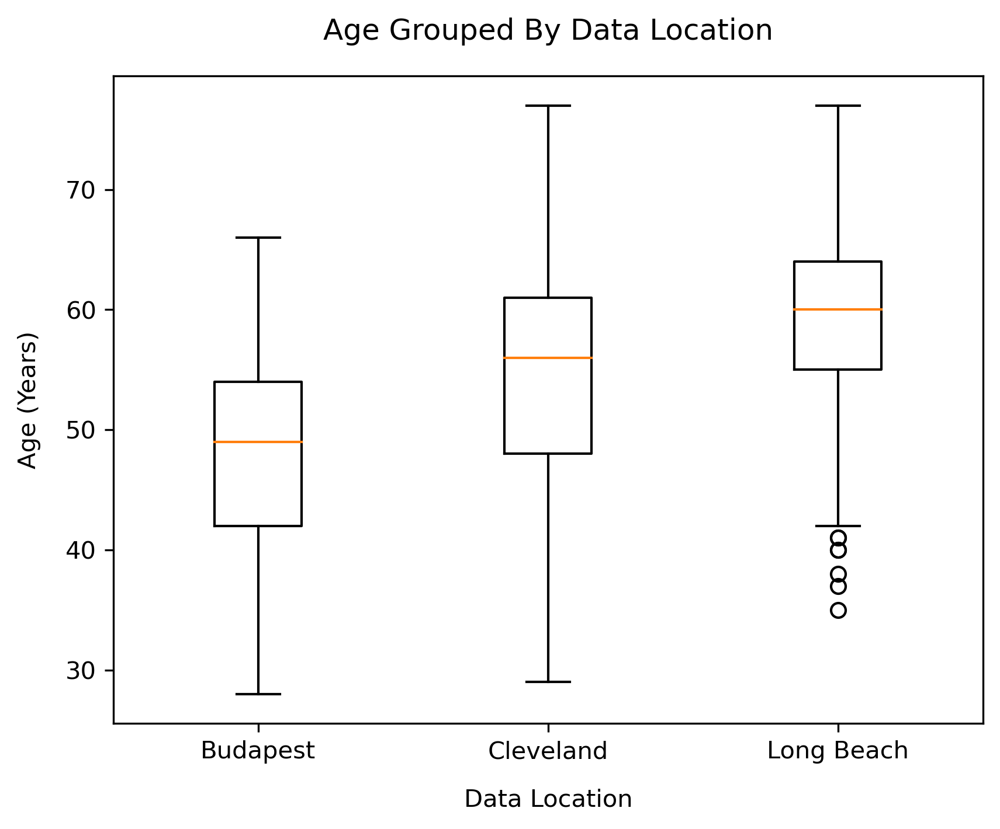

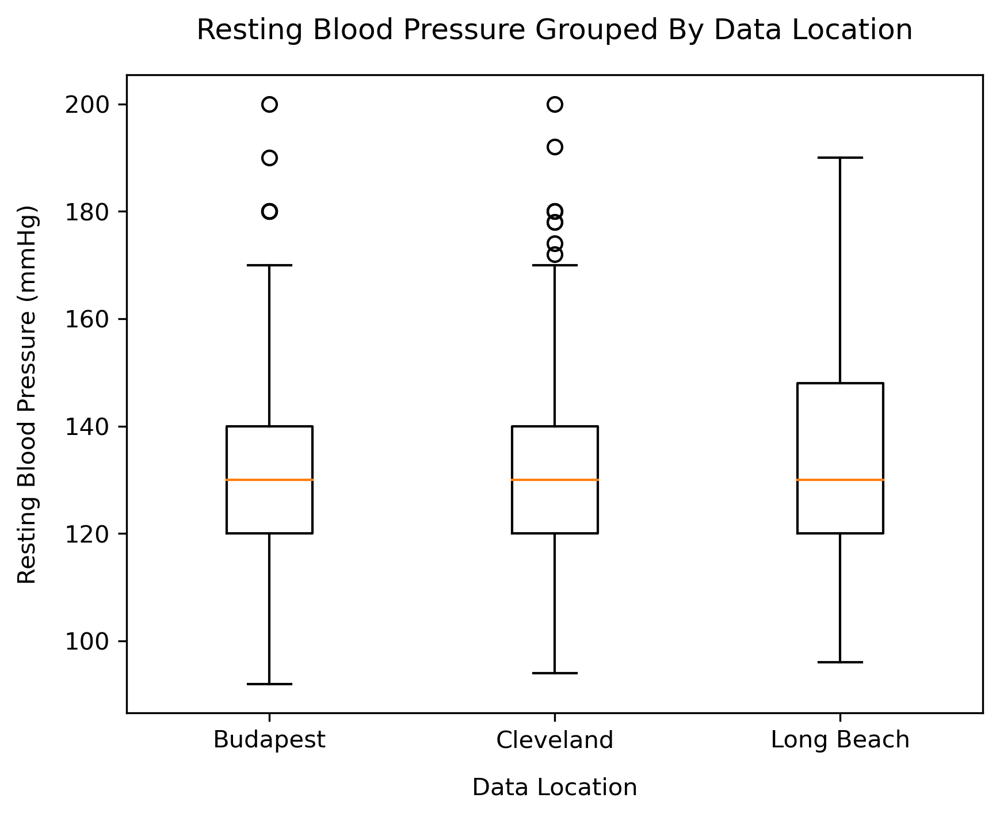

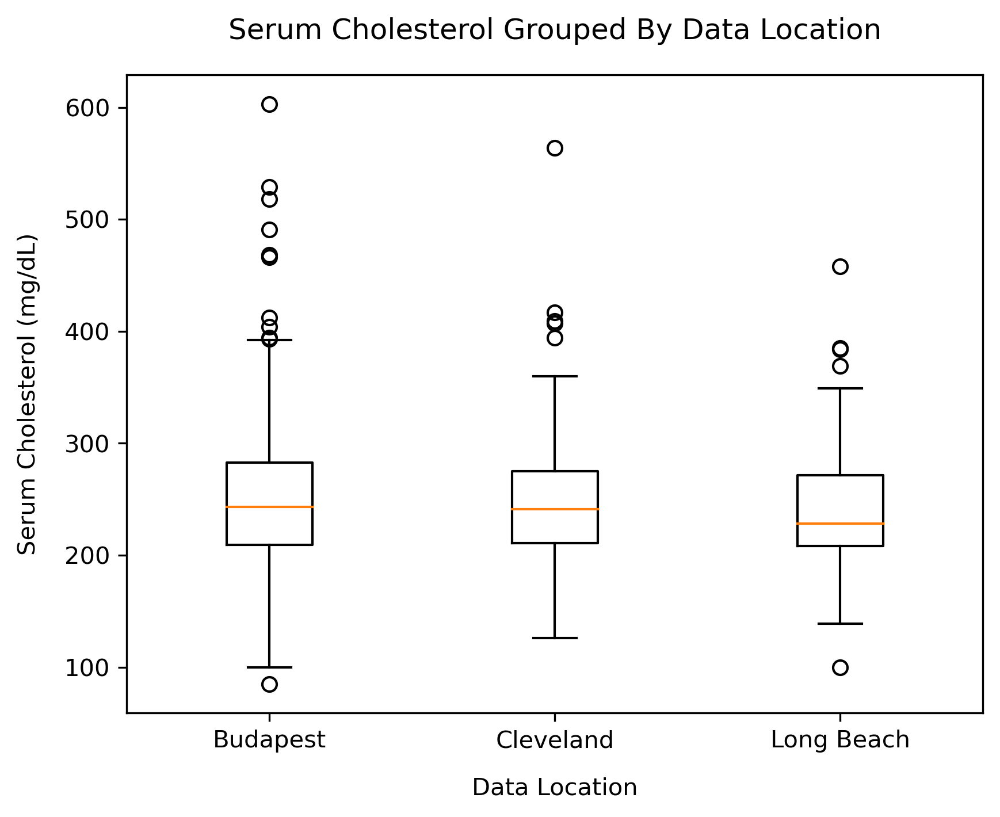

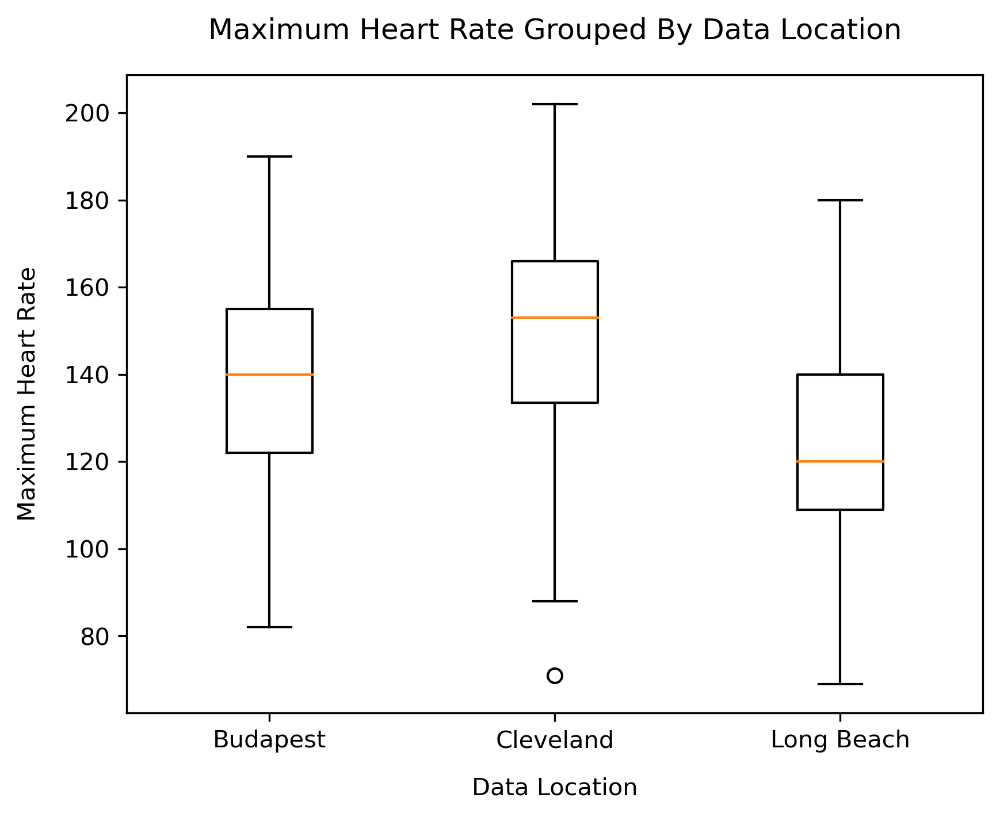

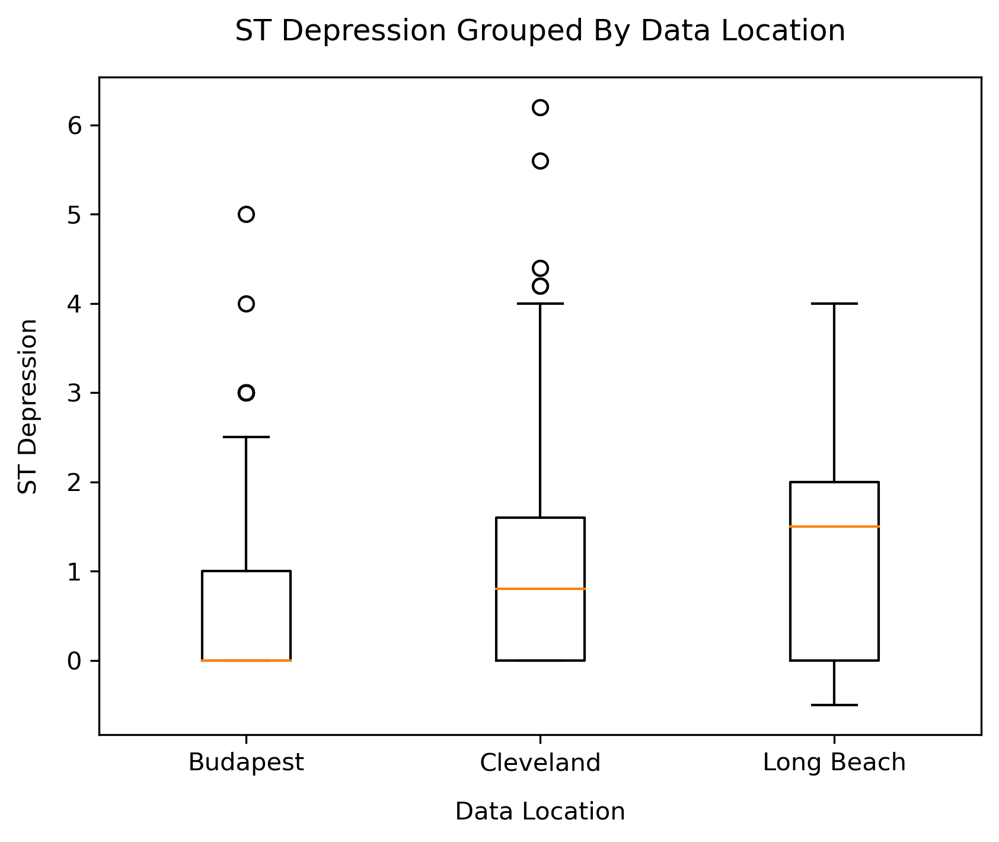

In [50]:
# plotting a box plot for all of the relevant features
for cat_ftr, num_ftr in product(cat_ftrs, num_ftrs):
    # initializing the feature name and axis label
    cat_ftr_name = ftr_names[cat_ftr]
    cat_ftr_axis = f'{cat_ftr_name} {ftr_units[cat_ftr]}' if cat_ftr in ftr_units else cat_ftr_name

    # initializing the feature name and axis label
    num_ftr_name = ftr_names[num_ftr]
    num_ftr_axis = f'{num_ftr_name} {ftr_units[num_ftr]}' if num_ftr in ftr_units else num_ftr_name

    # plotting a box plot for the current features
    plot_box(df, cat_ftr, num_ftr, cat_ftr_axis, num_ftr_axis, f'{num_ftr_name} Grouped By {cat_ftr_name}')

### Categorical Scatter Plots

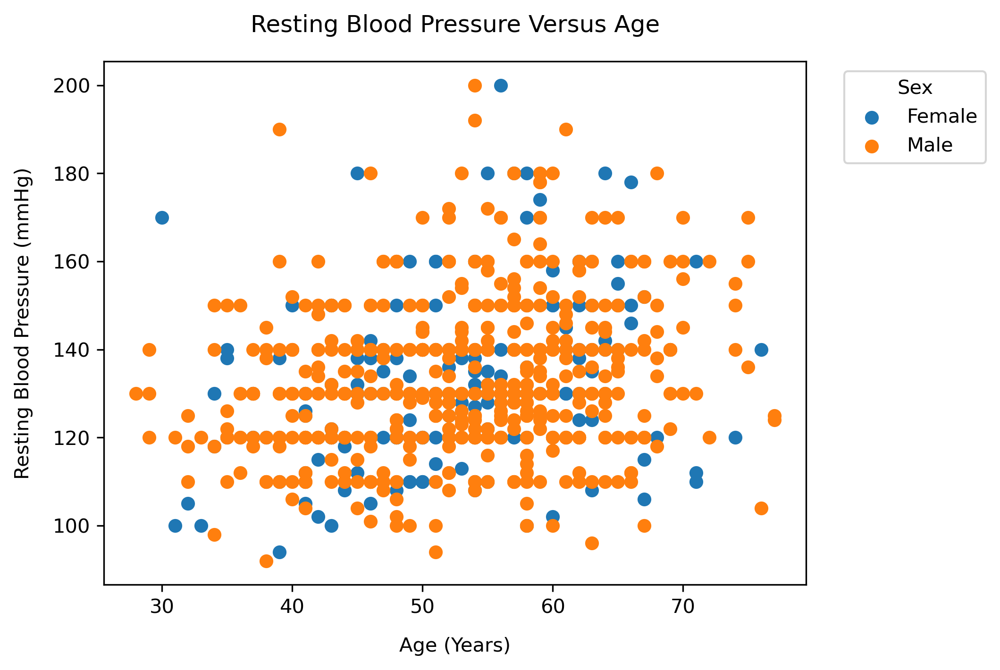

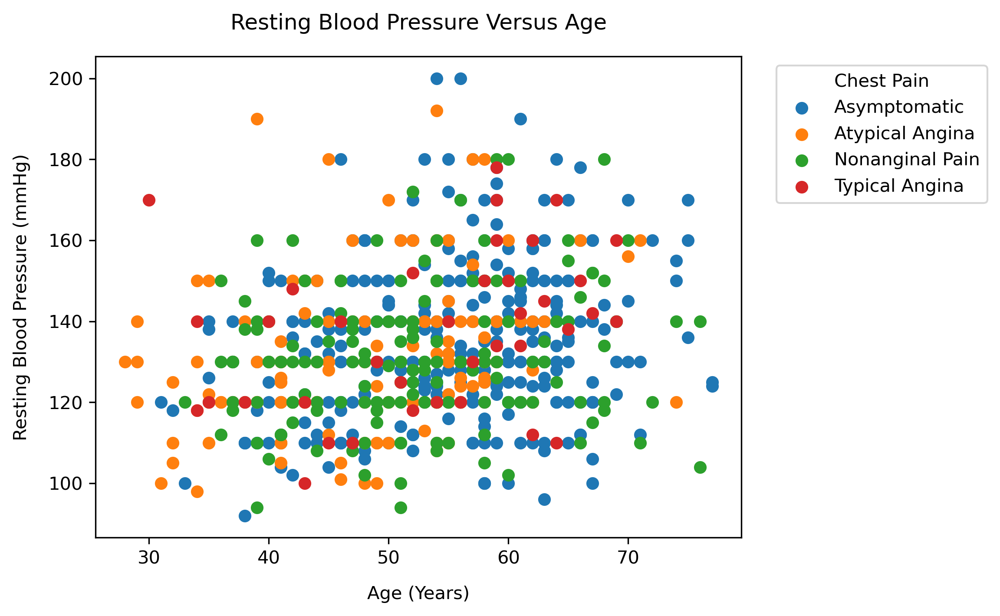

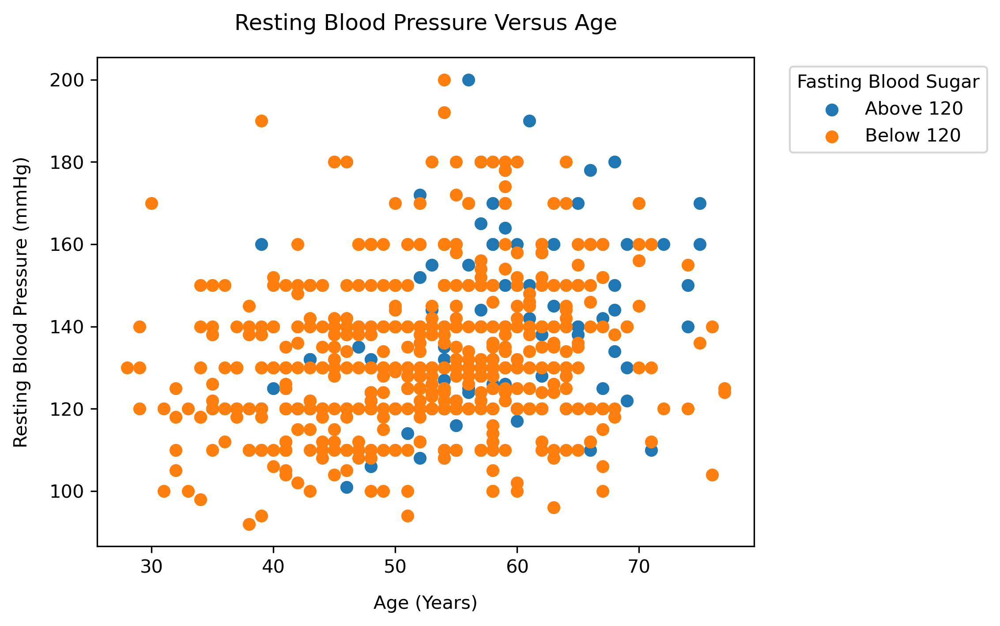

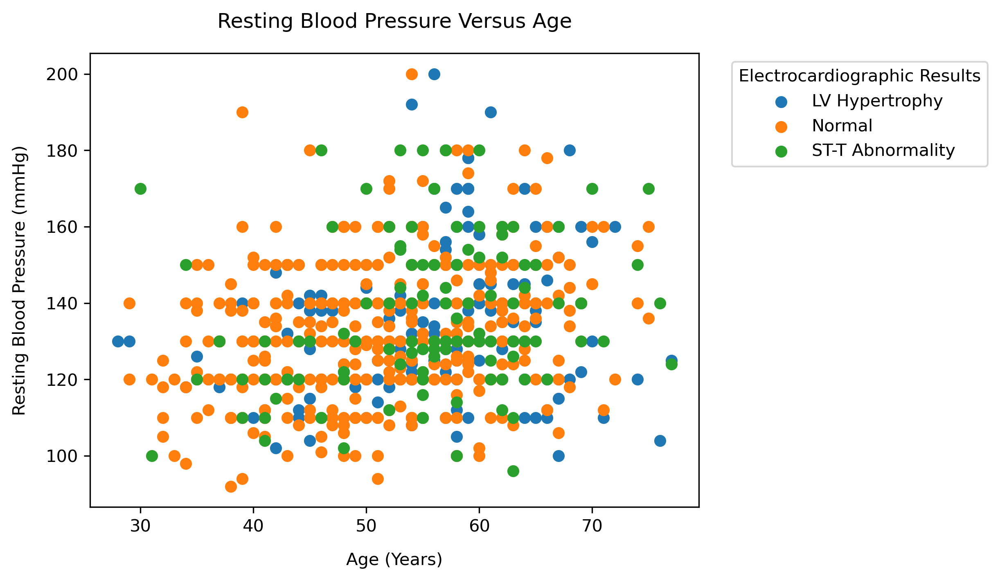

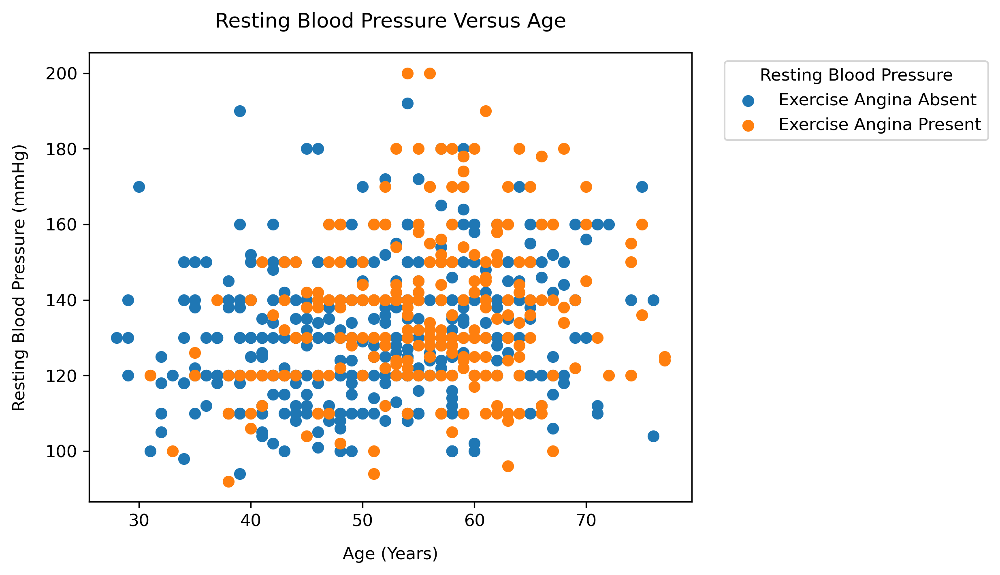

...

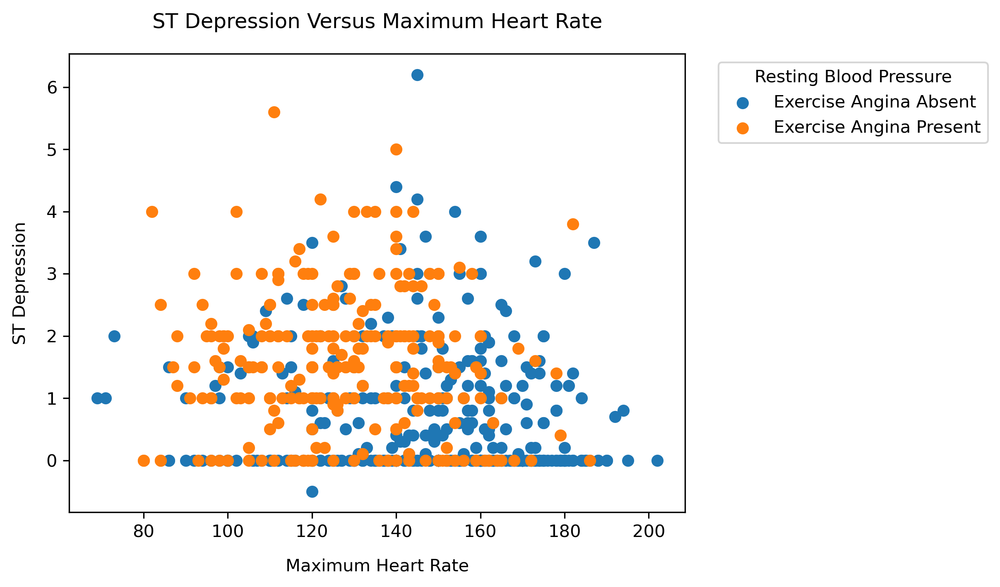

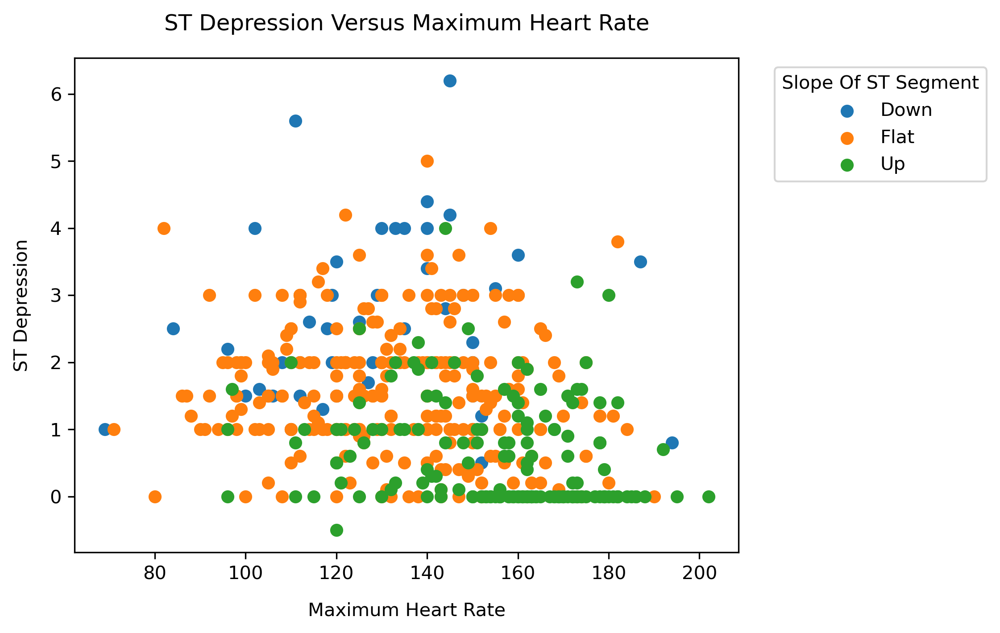

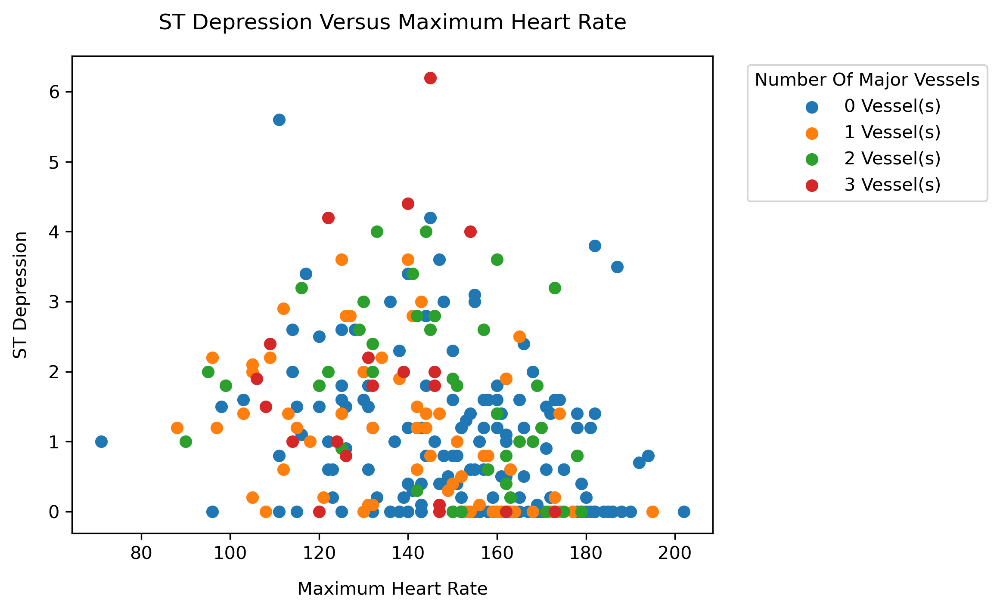

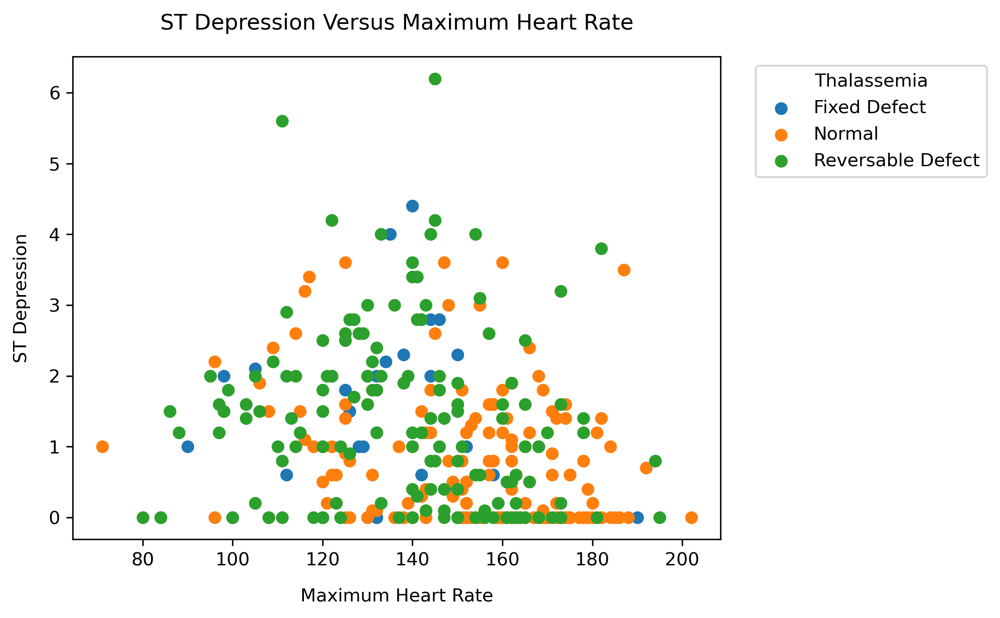

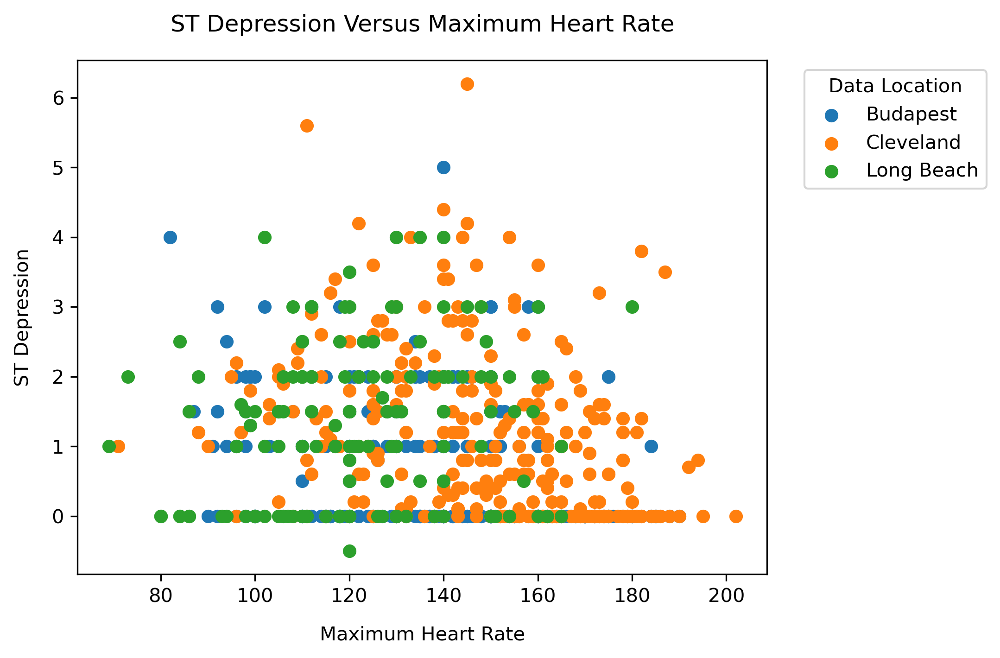

In [51]:
# plotting a categorical scatter plot for all of the relevant features
for (num_ftr1, num_ftr2), cat_ftr in product(combinations(num_ftrs, 2), cat_ftrs):
    # initializing the feature name and axis label
    num_ftr1_name = ftr_names[num_ftr1]
    num_ftr1_axis = f'{num_ftr1_name} {ftr_units[num_ftr1]}' if num_ftr1 in ftr_units else num_ftr1_name

    # initializing the feature name and axis label
    num_ftr2_name = ftr_names[num_ftr2]
    num_ftr2_axis = f'{num_ftr2_name} {ftr_units[num_ftr2]}' if num_ftr2 in ftr_units else num_ftr2_name

    # initializing the feature name and axis label
    cat_ftr_name = ftr_names[cat_ftr]
    cat_ftr_axis = f'{cat_ftr_name} {ftr_units[cat_ftr]}' if cat_ftr in ftr_units else cat_ftr_name

    # plotting a categorical scatter plot for the current features
    plot_categorical_scatter_u(df, num_ftr1, num_ftr2, cat_ftr, num_ftr1_axis, num_ftr2_axis, f'{num_ftr2_name} Versus {num_ftr1_name}', cat_ftr_name)

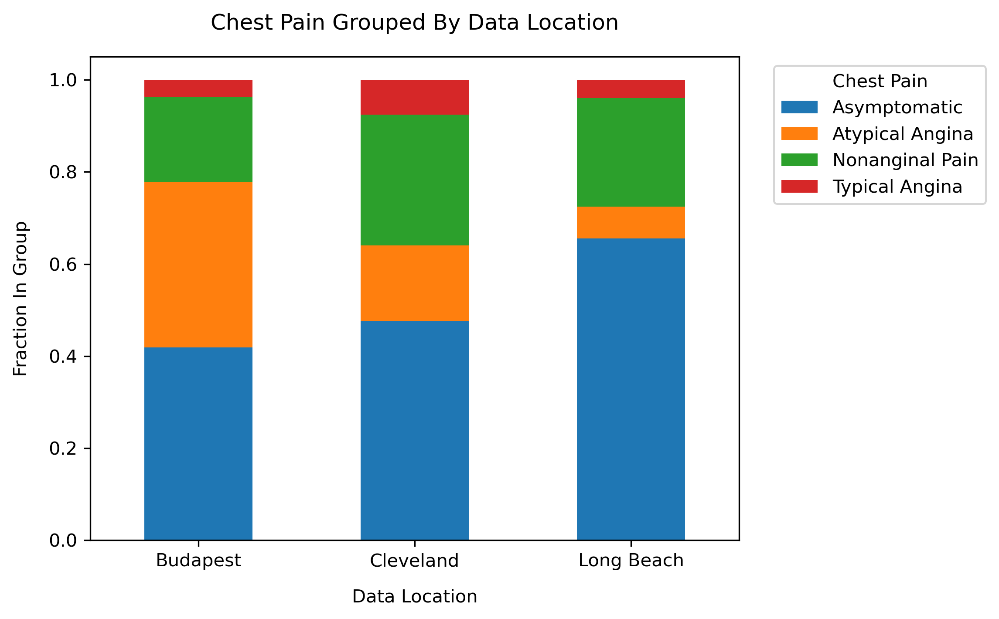

In [52]:
cat_ftr1, cat_ftr2 = 'location', 'cp'

# initializing the feature name and axis label
cat_ftr1_name = ftr_names[cat_ftr1]
cat_ftr1_axis = f'{cat_ftr1_name} {ftr_units[cat_ftr1]}' if cat_ftr1 in ftr_units else cat_ftr1_name

# initializing the feature name and axis label
cat_ftr2_name = ftr_names[cat_ftr2]
cat_ftr2_axis = f'{cat_ftr2_name} {ftr_units[cat_ftr2]}' if cat_ftr2 in ftr_units else cat_ftr2_name

# plotting a stacked bar plot for location and cp
plot_bar_stacked(df, cat_ftr1, cat_ftr2, cat_ftr1_axis, 'Fraction In Group', f'{cat_ftr2_name} Grouped By {cat_ftr1_name}', cat_ftr2_name)

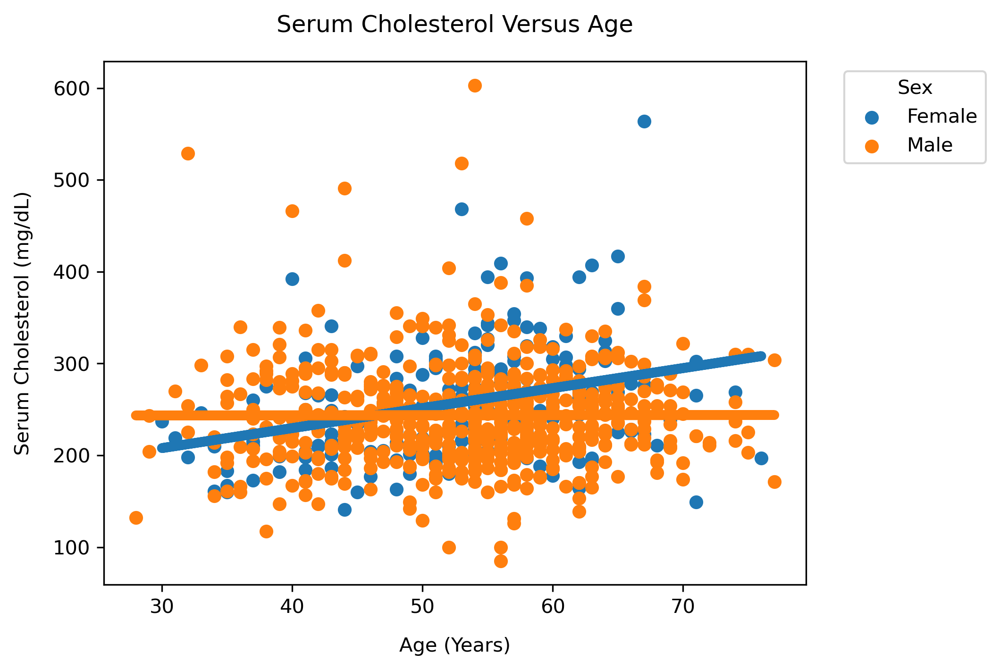

In [53]:
num_ftr1, num_ftr2, cat_ftr = 'age', 'chol', 'sex'

# initializing the feature name and axis label
num_ftr1_name = ftr_names[num_ftr1]
num_ftr1_axis = f'{num_ftr1_name} {ftr_units[num_ftr1]}' if num_ftr1 in ftr_units else num_ftr1_name

# initializing the feature name and axis label
num_ftr2_name = ftr_names[num_ftr2]
num_ftr2_axis = f'{num_ftr2_name} {ftr_units[num_ftr2]}' if num_ftr2 in ftr_units else num_ftr2_name

# initializing the feature name and axis label
cat_ftr_name = ftr_names[cat_ftr]
cat_ftr_axis = f'{cat_ftr_name} {ftr_units[cat_ftr]}' if cat_ftr in ftr_units else cat_ftr_name

# plotting a fitted categorical scatter plot for age, chol, and sex
plot_categorical_scatter_f(df, num_ftr1, num_ftr2, cat_ftr, num_ftr1_axis, num_ftr2_axis, f'{num_ftr2_name} Versus {num_ftr1_name}', cat_ftr_name)

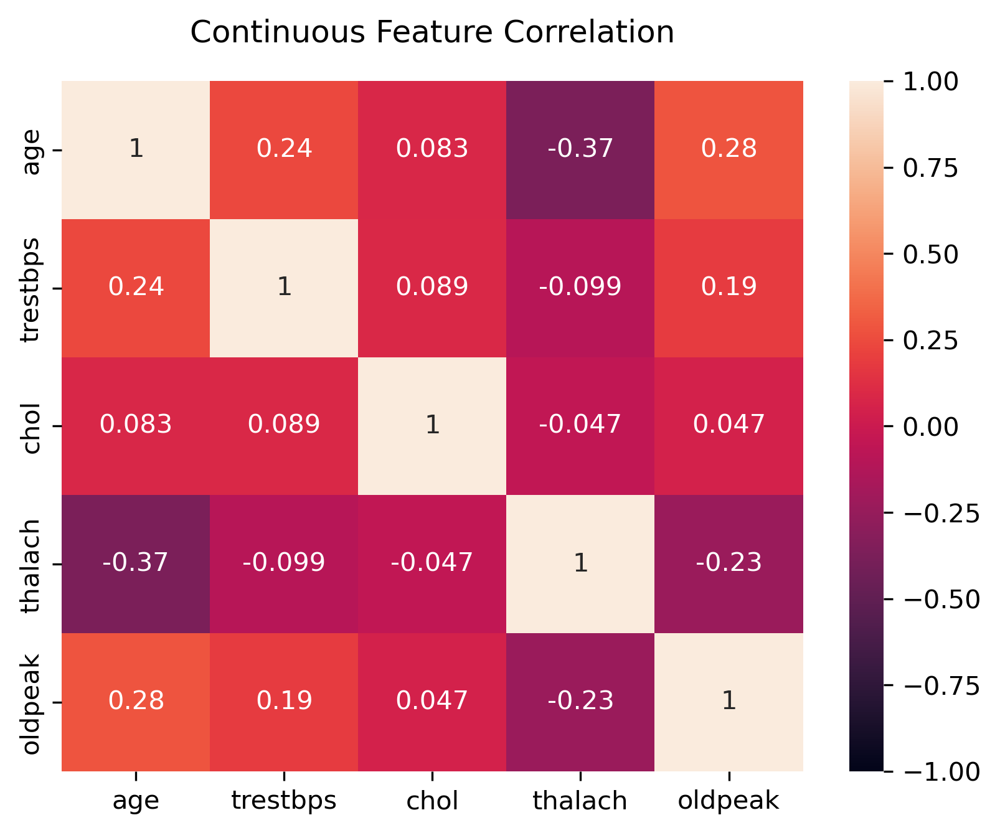

In [54]:
## initializing the continuous feature matrix
C = df.drop(['num', 'sex', 'cp', 'fbs', 'restecg', 'exang', 'slope', 'ca', 'thal', 'location'], axis=1)

# plotting the continuous feature correlation heatmap
corr_matrix = C.corr(method='pearson')
            
sns.heatmap(corr_matrix, vmin=-1, vmax=1, annot=True)
            
plt.title(f'Continuous Feature Correlation', pad=15)

plt.savefig(f'../figures/eda_figures/miscellaneous/correlation.png', bbox_inches='tight')